### Paso 1: Planteamiento del problema y recopilación de datos

In [82]:
###################################
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import numpy as np
import json

current_dir = os.getcwd()
path_config = os.path.join(current_dir, "../models")
url = os.path.join(current_dir, "../data/raw/demographic_health_data.csv")
pd.set_option('display.max_columns', None)
data = pd.read_csv(url, sep=",")
data.head()


,fips,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,40-49 y/o % of total pop,50-59,50-59 y/o % of total pop,60-69,60-69 y/o % of total pop,70-79,70-79 y/o % of total pop,80+,80+ y/o % of total pop,White-alone pop,% White-alone,Black-alone pop,% Black-alone,Native American/American Indian-alone pop,% NA/AI-alone,Asian-alone pop,% Asian-alone,Hawaiian/Pacific Islander-alone pop,% Hawaiian/PI-alone,Two or more races pop,% Two or more races,POP_ESTIMATE_2018,N_POP_CHG_2018,GQ_ESTIMATES_2018,R_birth_2018,R_death_2018,R_NATURAL_INC_2018,R_INTERNATIONAL_MIG_2018,R_DOMESTIC_MIG_2018,R_NET_MIG_2018,Less than a high school diploma 2014-18,High school diploma only 2014-18,Some college or associate's degree 2014-18,Bachelor's degree or higher 2014-18,Percent of adults with less than a high school diploma 2014-18,Percent of adults with a high school diploma only 2014-18,Percent of adults completing some college or associate's degree 2014-18,Percent of adults with a bachelor's degree or higher 2014-18,POVALL_2018,PCTPOVALL_2018,PCTPOV017_2018,PCTPOV517_2018,MEDHHINC_2018,CI90LBINC_2018,CI90UBINC_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018,Active Physicians per 100000 Population 2018 (AAMC),Total Active Patient Care Physicians per 100000 Population 2018 (AAMC),Active Primary Care Physicians per 100000 Population 2018 (AAMC),Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC),Active General Surgeons per 100000 Population 2018 (AAMC),Active Patient Care General Surgeons per 100000 Population 2018 (AAMC),Total nurse practitioners (2019),Total physician assistants (2019),Total Hospitals (2019),Internal Medicine Primary Care (2019),Family Medicine/General Practice Primary Care (2019),Total Specialist Physicians (2019),ICU Beds_x,Total Population,Population Aged 60+,Percent of Population Aged 60+,COUNTY_NAME,STATE_NAME,STATE_FIPS,CNTY_FIPS,county_pop2018_18 and older,anycondition_prevalence,anycondition_Lower 95% CI,anycondition_Upper 95% CI,anycondition_number,Obesity_prevalence,Obesity_Lower 95% CI,Obesity_Upper 95% CI,Obesity_number,Heart disease_prevalence,Heart disease_Lower 95% CI,Heart disease_Upper 95% CI,Heart disease_number,COPD_prevalence,COPD_Lower 95% CI,COPD_Upper 95% CI,COPD_number,diabetes_prevalence,diabetes_Lower 95% CI,diabetes_Upper 95% CI,diabetes_number,CKD_prevalence,CKD_Lower 95% CI,CKD_Upper 95% CI,CKD_number,Urban_rural_code
0,1001,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,13.636445,7738,13.917016,5826,10.478229,4050,7.284042,2014,3.622237,42660,76.725239,10915,19.630942,267,0.480207,681,1.224798,62,0.111509,1016,1.827305,55601,158,455,11.8,9.6,2.2,0.0,0.7,0.6,4204,12119,10552,10291,11.3,32.6,28.4,27.7,7587,13.8,19.3,19.5,59338,53628,65048,25957,25015,942,3.6,59338,119.0,217.1,196.7,77.2,71.2,7.6,6.9,28.859137,6.085786,1.148905,25.992561,21.249061,72.142154,6,55036,10523,19.1,Autauga,Alabama,1,1,42438,47.6,45.4,49.4,20181,35.8,34.2,37.3,15193,7.9,7.2,8.7,3345,8.6,7.3,9.9,3644,12.9,11.9,13.8,5462,3.1,2.9,3.3,1326,3
1,1003,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,12.539102,29986,13.753658,29932,13.728890,20936,9.602701,9368,4.296814,190301,87.285228,19492,8.940382,1684,0.772399,2508,1.150343,146,0.066966,3891,1.784682,218022,5403,2190,10.5,10.3,0.1,0.5,24.3,24.8,14310,40579,46025,46075,9.7,27.6,31.3,31.3,21069,9.8,13.9,13.1,57588,54437,60739,93849,90456,3393,3.6,57588,115.5,217.1,196.7,77.2,71.2,7.6,6.9,113.162114,23.863512,4.505074,101.921730,83.321572,282.882982,51,203360,53519,26.3,Baldwin,Alabama,1,3,170912,40.2,38.2,42.3,68790,29.7,28.4,31.0,50761,7.8,7.0,8.7,13414,8.6,7.2,10.1,14692,12.0,11.0,13.1,20520,3.2,3.0,3.5,5479,4
2,1005,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,12.354809,3278,13.174712,3076,12.3

Predecir qué factores (edad, ingresos, pobreza, acceso a salud, etc.) influyen en la cantidad de personas con alguna condición médica

### DROP COLUMNS
- fips,FIPS Code for the County,
- R_INTERNATIONAL_MIG_2018,Net international migration rate in period 7/1/2017 to 6/30/2018,
- R_DOMESTIC_MIG_2018,Net domestic migration rate in period 7/1/2017 to 6/30/2018,
- R_NET_MIG_2018,Net migration rate in period 7/1/2017 to 6/30/2018,
- STATE_FIPS,FIPS Code for the State,
- anycondition_Lower 95% CI,CI means confidence interval,
- anycondition_Upper 95% CI,,
- Obesity_Lower 95% CI,,
- Obesity_Upper 95% CI,,
- Heart disease_Lower 95% CI,,
- Heart disease_Upper 95% CI,,
- COPD_Lower 95% CI,,
- COPD_Upper 95% CI,,
- diabetes_Lower 95% CI,,
- diabetes_Upper 95% CI,,
- CKD_Lower 95% CI,,
- CKD_Upper 95% CI,,

### Categóricas
- Urban_rural_code
- COUNTY_NAME
- STATE_NAME

In [83]:
pd.reset_option('display.max_columns')

In [84]:
# Comentarios
#loan y housing -> tiene prestamo
# DEFINIR EL PROBLEMA: POR DEFECTO [LISTAS VACÍAS]
target = "anycondition_number"    # el target u objetivo del modelo. 
categorical_variable = ["Urban_rural_code","COUNTY_NAME","STATE_NAME"]  # Variables categóricas
drop_columns = [
                "fips", "R_INTERNATIONAL_MIG_2018", "R_DOMESTIC_MIG_2018", "R_NET_MIG_2018", "STATE_FIPS", "anycondition_Lower 95% CI", "anycondition_Upper 95% CI",
                "Obesity_Lower 95% CI", "Obesity_Upper 95% CI", "Heart disease_Lower 95% CI", "Heart disease_Upper 95% CI", "COPD_Lower 95% CI", "COPD_Upper 95% CI",
                "diabetes_Lower 95% CI","diabetes_Upper 95% CI","CKD_Lower 95% CI","CKD_Upper 95% CI"
                ] # columnas para hacer drop por falta de relevancia
factors_associated_target = []   # factores asociados al target. Relación del target con las predictoras. Subjetivo.



Se decide eliminar las siguientes columnas: "fips", "R_INTERNATIONAL_MIG_2018", "R_DOMESTIC_MIG_2018", "R_NET_MIG_2018", "STATE_FIPS", "anycondition_Lower 95% CI", "anycondition_Upper 95% CI", "Obesity_Lower 95% CI", "Obesity_Upper 95% CI", "Heart disease_Lower 95% CI", "Heart disease_Upper 95% CI", "COPD_Lower 95% CI", "COPD_Upper 95% CI", "diabetes_Lower 95% CI","diabetes_Upper 95% CI","CKD_Lower 95% CI","CKD_Upper 95% CI".

### Paso 2: Exploración y limpieza de datos

In [85]:
# Obtener las dimensiones
data.shape

(3140, 108)

In [86]:
# Obtener información sobre tipos de datos y valores no nulos
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3140 entries, 0 to 3139
Columns: 108 entries, fips to Urban_rural_code
dtypes: float64(61), int64(45), object(2)
memory usage: 2.6+ MB


In [87]:
nan = data.isna().sum().sort_values(ascending=False)
nan

fips                      0
TOT_POP                   0
0-9                       0
0-9 y/o % of total pop    0
19-Oct                    0
                         ..
CKD_prevalence            0
CKD_Lower 95% CI          0
CKD_Upper 95% CI          0
CKD_number                0
Urban_rural_code          0
Length: 108, dtype: int64

In [88]:
data.columns

Index(['fips', 'TOT_POP', '0-9', '0-9 y/o % of total pop', '19-Oct',
       '10-19 y/o % of total pop', '20-29', '20-29 y/o % of total pop',
       '30-39', '30-39 y/o % of total pop',
       ...
       'COPD_number', 'diabetes_prevalence', 'diabetes_Lower 95% CI',
       'diabetes_Upper 95% CI', 'diabetes_number', 'CKD_prevalence',
       'CKD_Lower 95% CI', 'CKD_Upper 95% CI', 'CKD_number',
       'Urban_rural_code'],
      dtype='object', length=108)

- Existen un total de 3140 filas (en este caso, reservas de airbnb) y 108 columnas, de entre las que encontramos el objetivo o clase a predecir, `anycondition_number`.
- No hay valores nulos, el resto de variables cuentan siempre con valor.
- Los datos cuentan con 105 características numéricas y 3 características categóricas.

#### Eliminar duplicados
Se decide eliminar `drop_columns`, ya que se observa son poco o nada relevantes para el target.

In [89]:
drop_columns

['fips',
 'R_INTERNATIONAL_MIG_2018',
 'R_DOMESTIC_MIG_2018',
 'R_NET_MIG_2018',
 'STATE_FIPS',
 'anycondition_Lower 95% CI',
 'anycondition_Upper 95% CI',
 'Obesity_Lower 95% CI',
 'Obesity_Upper 95% CI',
 'Heart disease_Lower 95% CI',
 'Heart disease_Upper 95% CI',
 'COPD_Lower 95% CI',
 'COPD_Upper 95% CI',
 'diabetes_Lower 95% CI',
 'diabetes_Upper 95% CI',
 'CKD_Lower 95% CI',
 'CKD_Upper 95% CI']

In [90]:
nan_percentage = data.isna().mean()*100
# Identificar las columnas con más del 90% de NaN y eliminarlas directamente
columns_to_drop = nan[nan_percentage > 90].index
print(columns_to_drop)
# Eliminar las columnas
data_cleaned = data.drop(columns=columns_to_drop, axis=1)

data

Index([], dtype='object')


,fips,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,...,COPD_number,diabetes_prevalence,diabetes_Lower 95% CI,diabetes_Upper 95% CI,diabetes_number,CKD_prevalence,CKD_Lower 95% CI,CKD_Upper 95% CI,CKD_number,Urban_rural_code
0,1001,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,...,3644,12.9,11.9,13.8,5462,3.1,2.9,3.3,1326,3
1,1003,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,...,14692,12.0,11.0,13.1,20520,3.2,3.0,3.5,5479,4
2,1005,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,...,2373,19.7,18.6,20.6,3870,4.5,4.2,4.8,887,6
3,1007,22400,2456,10.964286,2596,11.589286,3029,13.522321,3113,13.897321,...,1789,14.1,13.2,14.9,2511,3.3,3.1,3.6,595,2
4,1009,57840,7095,12.266598,7570,13.087828,6742,11.656293,6884,11.901798,...,4661,13.5,12.6,14.5,6017,3.4,3.2,3.7,1507,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,56037,43051,6104,14.178532,6326,14.694200,5359,12.448027,6577,15.277229,...,2098,8.9,8.3,9.6,2834,2.6,2.4,2.8,821,5
3136,56039,23081,2384,10.328842,2185,9.466661,2967,12.854729,4093,17.733200,...,928,7.2,6.5,8.0,1360,2.4,2.2,2.6,447,5
3137,56041,20299,3121,15.375142,3205,15.788955,2153,10.606434,2702,13.311001,...,1163,10.4,9.5,11.2,1500,3.0,2.8,3.2,430,5
3138,56043,7885,858,10.881420,1113,14.115409,715,9.067850,903,11.452124,...,506,11.3,10.3,12.1,686,3.4,3.2,3.7,207,6


In [91]:
duplicated_row = data.duplicated().sum()
duplicated_row

np.int64(0)

In [92]:

if(duplicated_row==0):
    print("No hay duplicados")
else:
    print("Si hay duplicados, se procede a eliminarlos")

No hay duplicados


No se encuentran valores duplicados.

In [93]:
# data = data.drop_duplicates(subset = data.columns.difference(["id"]))
# data.shape

In [94]:
# ELIMINAR DUPLICADOS, ESPECIFICAR CON .difference(["id"] SI ES NECESARIO
data = data.drop_duplicates(subset = data.columns)
print(data.shape)
data.head()

(3140, 108)


,fips,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,...,COPD_number,diabetes_prevalence,diabetes_Lower 95% CI,diabetes_Upper 95% CI,diabetes_number,CKD_prevalence,CKD_Lower 95% CI,CKD_Upper 95% CI,CKD_number,Urban_rural_code
0,1001,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,...,3644,12.9,11.9,13.8,5462,3.1,2.9,3.3,1326,3
1,1003,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,...,14692,12.0,11.0,13.1,20520,3.2,3.0,3.5,5479,4
2,1005,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,...,2373,19.7,18.6,20.6,3870,4.5,4.2,4.8,887,6
3,1007,22400,2456,10.964286,2596,11.589286,3029,13.522321,3113,13.897321,...,1789,14.1,13.2,14.9,2511,3.3,3.1,3.6,595,2
4,1009,57840,7095,12.266598,7570,13.087828,6742,11.656293,6884,11.901798,...,4661,13.5,12.6,14.5,6017,3.4,3.2,3.7,1507,2


Se procede a eliminar las columnas que hayamos definido en `drop_columns` cuando hemos definido el problema.

In [95]:
if(len(drop_columns) > 0):   # si drop_columns tiene valores y no está vacío entra
    data = data.drop(drop_columns, axis = 1)
data

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,Obesity_number,Heart disease_prevalence,Heart disease_number,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code
0,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,...,15193,7.9,3345,8.6,3644,12.9,5462,3.1,1326,3
1,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,...,50761,7.8,13414,8.6,14692,12.0,20520,3.2,5479,4
2,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,...,8013,11.0,2159,12.1,2373,19.7,3870,4.5,887,6
3,22400,2456,10.964286,2596,11.589286,3029,13.522321,3113,13.897321,3038,...,6894,8.6,1533,10.0,1789,14.1,2511,3.3,595,2
4,57840,7095,12.266598,7570,13.087828,6742,11.656293,6884,11.901798,7474,...,15112,9.2,4101,10.5,4661,13.5,6017,3.4,1507,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,43051,6104,14.178532,6326,14.694200,5359,12.448027,6577,15.277229,5334,...,10672,5.9,1862,6.6,2098,8.9,2834,2.6,821,5
3136,23081,2384,10.328842,2185,9.466661,2967,12.854729,4093,17.733200,3423,...,3655,5.2,981,4.9,928,7.2,1360,2.4,447,5
3137,20299,3121,15.375142,3205,15.788955,2153,10.606434,2702,13.311001,2390,...,4944,7.2,1034,8.0,1163,10.4,1500,3.0,430,5
3138,7885,858,10.881420,1113,14.115409,715,9.067850,903,11.452124,900,...,1730,8.2,500,8.3,506,11.3,686,3.4,207,6


In [96]:
data.describe()

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,Obesity_number,Heart disease_prevalence,Heart disease_number,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code
count,3.140000e+03,3.140000e+03,3140.000000,3.140000e+03,3140.000000,3.140000e+03,3140.000000,3.140000e+03,3140.000000,3.140000e+03,...,3.140000e+03,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000
mean,1.041894e+05,1.274030e+04,11.871051,1.336798e+04,12.694609,1.446933e+04,12.283979,1.391649e+04,11.751535,1.288521e+04,...,2.527613e+04,8.607803,5597.593312,9.095223,5827.242357,13.073503,9326.577707,3.446242,2466.234076,4.635350
std,3.335834e+05,4.180730e+04,2.124081,4.228439e+04,1.815044,4.957773e+04,3.126297,4.899095e+04,1.696599,4.347219e+04,...,7.446684e+04,1.758587,15615.285499,2.344965,15720.551934,2.724351,29754.601185,0.568059,7730.422067,1.510447
min,8.800000e+01,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,1.100000e+01,6.092789,4.000000e+00,...,2.500000e+01,3.500000,7.000000,3.500000,7.000000,6.100000,11.000000,1.800000,3.000000,1.000000
25%,1.096325e+04,1.280500e+03,10.594639,1.374500e+03,11.674504,1.263750e+03,10.496774,1.232750e+03,10.689322,1.245250e+03,...,3.075000e+03,7.400000,798.500000,7.300000,815.000000,11.200000,1187.750000,3.100000,314.750000,3.000000
50%,2.580050e+04,3.057000e+03,11.802727,3.274000e+03,12.687422,3.108000e+03,11.772649,3.000500e+03,11.580861,3.048500e+03,...,7.182500e+03,8.600000,1814.500000,8.900000,1963.500000,12.800000,2743.000000,3.400000,718.000000,5.000000
75%,6.791300e+04,8.097000e+03,12.951840,8.822250e+03,13.659282,8.976250e+03,13.182260,8.314250e+03,12.639379,8.120500e+03,...,1.854250e+04,9.800000,4376.000000,10.600000,4727.000000,14.800000,6679.250000,3.800000,1776.250000,6.000000
max,1.010552e+07,1.208253e+06,25.460677,1.239139e+06,23.304372,1.557073e+06,37.570198,1.501844e+06,22.225129,1.350076e+06,...,2.097906e+06,15.100000,434790.000000,19.900000,434075.000000,25.600000,952335.000000,6.200000,237766.000000,6.000000


### Paso 3: Análisis de variables univariante

#### Análisis sobre variables categóricas

In [97]:
categorical_variable

['Urban_rural_code', 'COUNTY_NAME', 'STATE_NAME']

Variables categóricas
Una **variable categórica** es un tipo de variable que puede tomar uno de un número limitado de categorías o grupos. Estos grupos son a menudo nominales (por ejemplo, el color de un coche: rojo, azul, negro, etc, pero ninguno de estos colores es inherentemente "mayor" o "mejor" que los demás) pero pueden también representarse mediante números finitos.

Para representar este tipo de variables utilizaremos histogramas. Antes de comenzar a graficar, debemos identificar cuáles son categóricas, y se puede comprobar fácilmente analizando el rango de valores. En este caso, las variables categóricas son:
 'Urban_rural_code', 'COUNTY_NAME', 'STATE_NAME'.

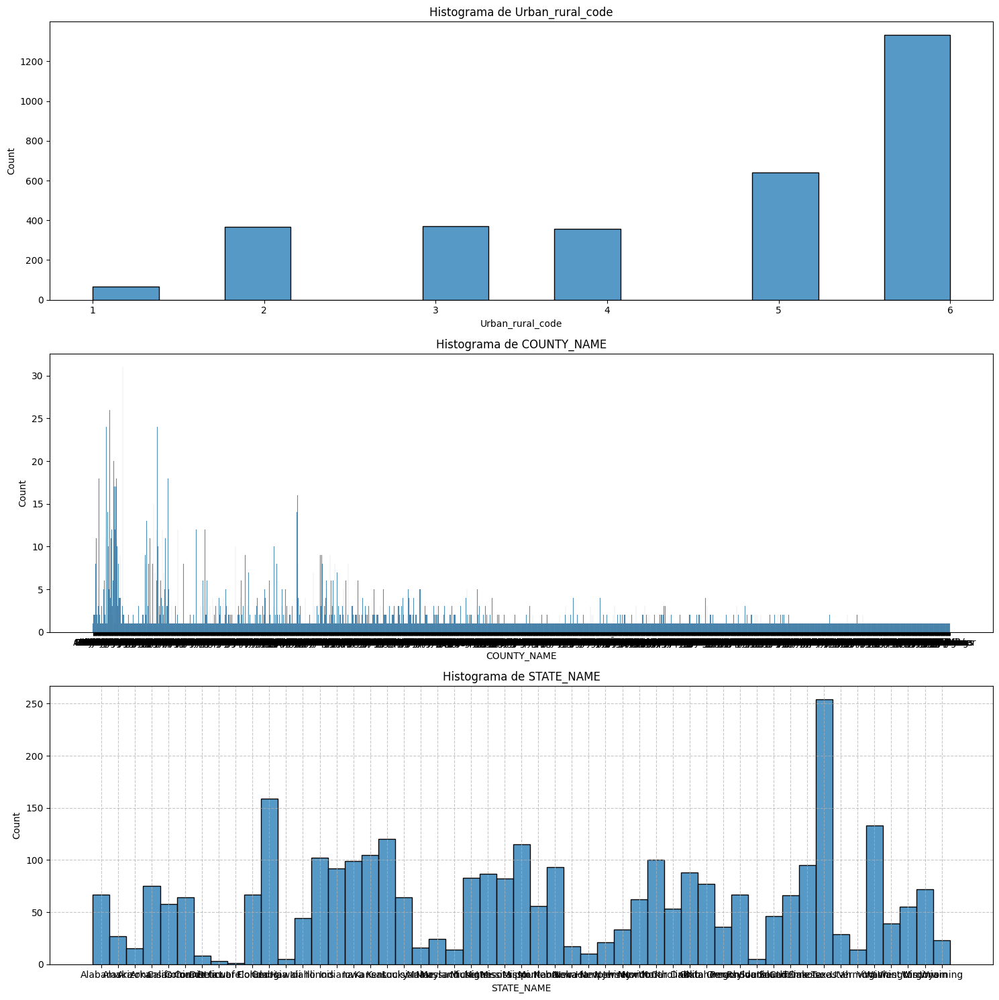

In [98]:
if(categorical_variable):
    fig, axis = plt.subplots(len(categorical_variable), 1,figsize = (15, 5*len(categorical_variable)))
    if len(categorical_variable) == 1:
        axis = [axis]   # convertir en lista para que no me salga error

    for i,col in enumerate(categorical_variable):
        # Crear un histograma múltiple
        sns.histplot( data = data, ax=axis[i], x = col)
        axis[i].set_title(f'Histograma de {col}')
        # grid
        plt.grid(linestyle="--", alpha=0.7)
        # Ajustar el layout
        plt.tight_layout()

        # Rotación automática de las etiquetas del eje X si es necesario.
        # category_counts = data[col].value_counts() # Contar las categorías en la columna.
        # if len(category_counts) > 20: # Si hay más de 20 categorías, eliminar las etiquetas del eje X
        #     axis[i].set_xticklabels([])
        # elif len(category_counts) >= 8:
        #     for label in axis[i].get_xticklabels(): # Si hay más de 10 categorías pero menos de 20, rotar las etiquetas del eje X

    # Mostrar el plot
    plt.show()
else:
    print("categorical_variable está vacío, debe llenarse para poder representarse")

In [99]:
categorical_variable

['Urban_rural_code', 'COUNTY_NAME', 'STATE_NAME']

- 'Urban_rural_code': Se observa que el valor 6 que corresponde con 6 `(Urban population of 2,500 to 19,999, adjacent to a metro area)` es el que es mayor que el resto.
- 'COUNTY_NAME': Se observa una gran cantidad de nombres que imposibilitan ver con claridad algo destacable.
- 'STATE_NAME': It distinguishes metropolitan (metro) counties by the population size of their metro area, and nonmetropolitan (nonmetro) counties by degree of urbanization and adjacency to a metro area or areas. Se observa que la una gran fluctuación entre los valores.


#### Análisis sobre variables numéricas

Antes de comenzar a graficar, debemos identificar cuáles son las numéricas, que son 108. Se procede a graficar de forma automática:

In [100]:
data.select_dtypes(include='number').columns

Index(['TOT_POP', '0-9', '0-9 y/o % of total pop', '19-Oct',
       '10-19 y/o % of total pop', '20-29', '20-29 y/o % of total pop',
       '30-39', '30-39 y/o % of total pop', '40-49',
       '40-49 y/o % of total pop', '50-59', '50-59 y/o % of total pop',
       '60-69', '60-69 y/o % of total pop', '70-79',
       '70-79 y/o % of total pop', '80+', '80+ y/o % of total pop',
       'White-alone pop', '% White-alone', 'Black-alone pop', '% Black-alone',
       'Native American/American Indian-alone pop', '% NA/AI-alone',
       'Asian-alone pop', '% Asian-alone',
       'Hawaiian/Pacific Islander-alone pop', '% Hawaiian/PI-alone',
       'Two or more races pop', '% Two or more races', 'POP_ESTIMATE_2018',
       'N_POP_CHG_2018', 'GQ_ESTIMATES_2018', 'R_birth_2018', 'R_death_2018',
       'R_NATURAL_INC_2018', 'Less than a high school diploma 2014-18',
       'High school diploma only 2014-18',
       'Some college or associate's degree 2014-18',
       'Bachelor's degree or higher 201

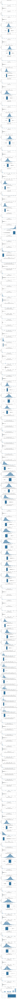

In [101]:
import matplotlib.pyplot as plt
import seaborn as sns
# SOLO MODIFICAR COLUMNAS QUE SE QUIERAN EXCLUIR DE LAS NUMERICAS []
column_filter= data.select_dtypes(include='number').drop(columns=[''], errors='ignore').columns
# Crear la figura con 2 columnas y una fila por variable
fig, axes = plt.subplots(len(column_filter)*2, 1, figsize=(8, len(column_filter) * 5))

# Iterar sobre cada columna del DataFrame
for i, col in enumerate(column_filter):
    idx=i*2
    # Histograma en la primera fila
    sns.histplot(data=data, x=col, kde=True, ax=axes[idx])
    axes[idx].set_title(f'Histograma de {col}')
    
    # set_limitx -> ajustar gráficos si interesa. Ver si sería interesante hacerlo
    # if col in x_limits:
    #     axis[idx+1].set_xlim(x_limits[col])

    # Boxplot en la segunda fila
    sns.boxplot(data=data, x=col, ax=axes[idx+1])
    axes[idx+1].set_title(f'Boxplot de {col}')
    

# Ajustar diseño
plt.tight_layout()
plt.show()

In [102]:
len(data.select_dtypes(include='number').columns)

89

- Como se menciona más adelante de las 92 predictoras numéricas todas siguen una distribución normal, siendo algunas de ellas una distribución normal sesgada a la izquierda.

La combinación de los dos gráficos anteriores por cada variable nos permite conocer la distribución y sus características estadísticas. De la visualización resultante podemos ver que gran parte siguen una distribución normal, unas pocas siguen una distribución normal sesgada a la izquierda.

### Paso 4: Análisis de variables multivariante

Tras analizar las características una a una, es momento de analizarlas en relación con la predictora y con ellas mismas, para sacar conclusiones más claras acerca de sus relaciones y poder tomar decisiones sobre su procesamiento.

Así, si quisiéramos eliminar una variable debido a una alta cantidad de valores nulos o ciertos outliers, es necesario antes aplicar este proceso para asegurar que la eliminación de ciertos valores no son críticos. 

#### Análisis numérico-numérico

Para comparar dos columnas numéricas se utilizan diagramas de dispersión y análisis de correlaciones.
##### Target: anycondition_number - 108 columnas numéricas

In [103]:
data.select_dtypes(include='number').columns

Index(['TOT_POP', '0-9', '0-9 y/o % of total pop', '19-Oct',
       '10-19 y/o % of total pop', '20-29', '20-29 y/o % of total pop',
       '30-39', '30-39 y/o % of total pop', '40-49',
       '40-49 y/o % of total pop', '50-59', '50-59 y/o % of total pop',
       '60-69', '60-69 y/o % of total pop', '70-79',
       '70-79 y/o % of total pop', '80+', '80+ y/o % of total pop',
       'White-alone pop', '% White-alone', 'Black-alone pop', '% Black-alone',
       'Native American/American Indian-alone pop', '% NA/AI-alone',
       'Asian-alone pop', '% Asian-alone',
       'Hawaiian/Pacific Islander-alone pop', '% Hawaiian/PI-alone',
       'Two or more races pop', '% Two or more races', 'POP_ESTIMATE_2018',
       'N_POP_CHG_2018', 'GQ_ESTIMATES_2018', 'R_birth_2018', 'R_death_2018',
       'R_NATURAL_INC_2018', 'Less than a high school diploma 2014-18',
       'High school diploma only 2014-18',
       'Some college or associate's degree 2014-18',
       'Bachelor's degree or higher 201

In [104]:
# Automatizado para solo filtrar los numericos a numericos y excluir que se compare el objetivo o clase a predecir, es decir, price consigo mismo
# if(target):
    

#     # if pd.api.types.is_numeric_dtype(data[target]):
#     #     print("La columna es numérica.")
#     # else:
#     #     print("La columna NO es numérica.")
#     column_filter= data.select_dtypes(include='number').drop(columns=[target], errors='ignore').columns
#     num_vars = len(column_filter)
#     fig, axis = plt.subplots(num_vars, 2, figsize = (10, 7*num_vars), squeeze=False)

#     # Crear un diagrama de dispersión múltiple y la matriz de correlación entre las dos variables (predictora-target)
#     for i,col in enumerate(column_filter):
#         sns.regplot(ax = axis[i, 0], data = data, x = col, y = target)
#         sns.heatmap(data[[target, col]].corr(), annot = True, fmt = ".2f", ax = axis[i,1], cbar = True)

#     # Ajustar el layout
#     plt.tight_layout()

#     # Mostrar el plot
#     plt.show()
# else:
#     print(f"target {target} está vacío, se debe especificar el target para poder representar.")

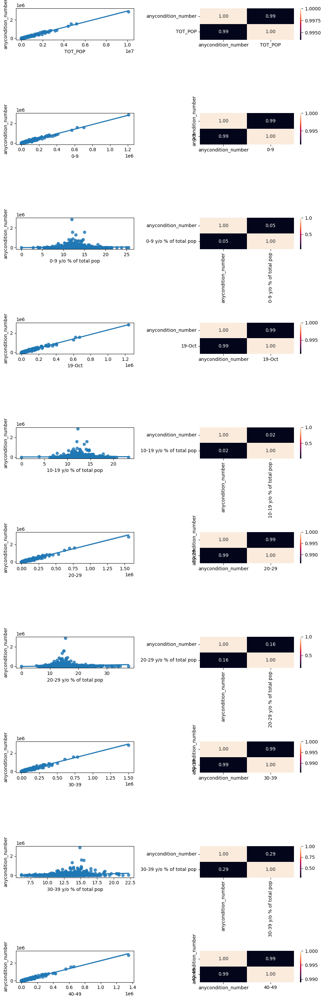

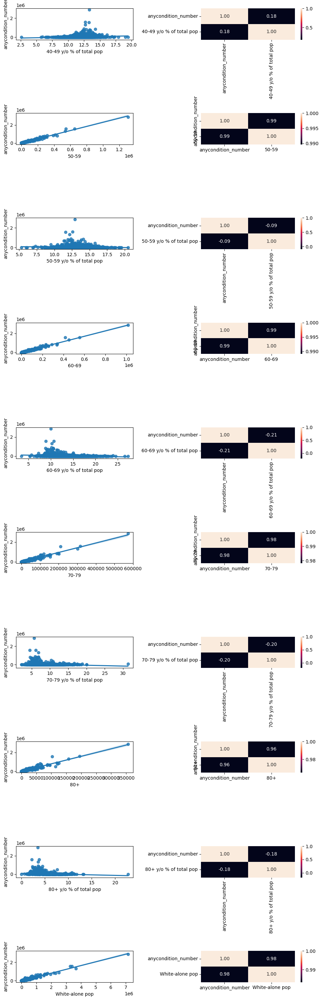

C:\Users\mamen\AppData\Local\Temp\ipykernel_20780\4018811909.py:16: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


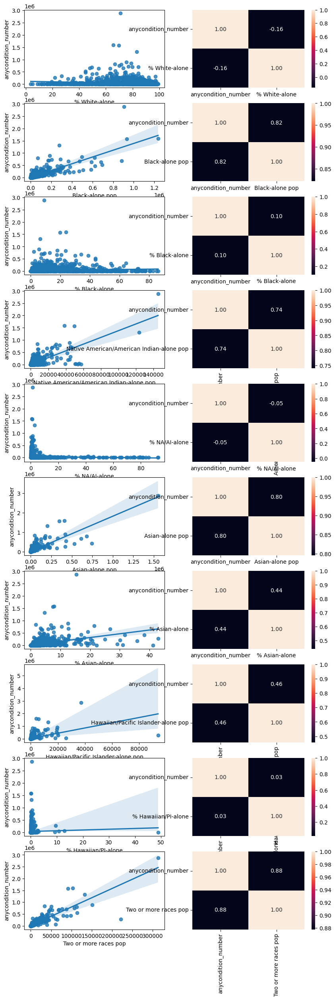

C:\Users\mamen\AppData\Local\Temp\ipykernel_20780\4018811909.py:16: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


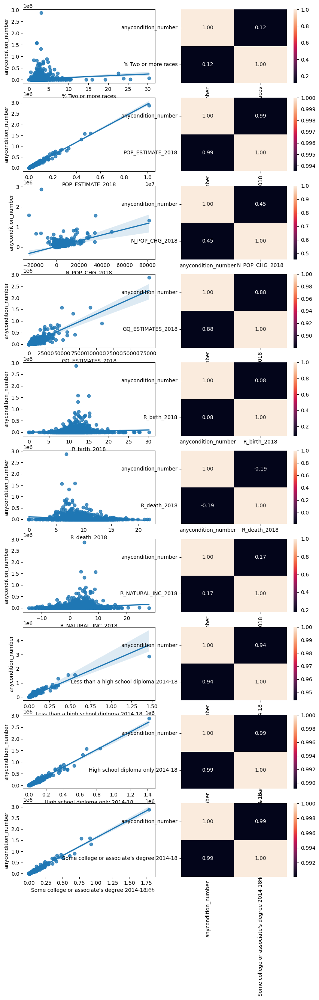

C:\Users\mamen\AppData\Local\Temp\ipykernel_20780\4018811909.py:16: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


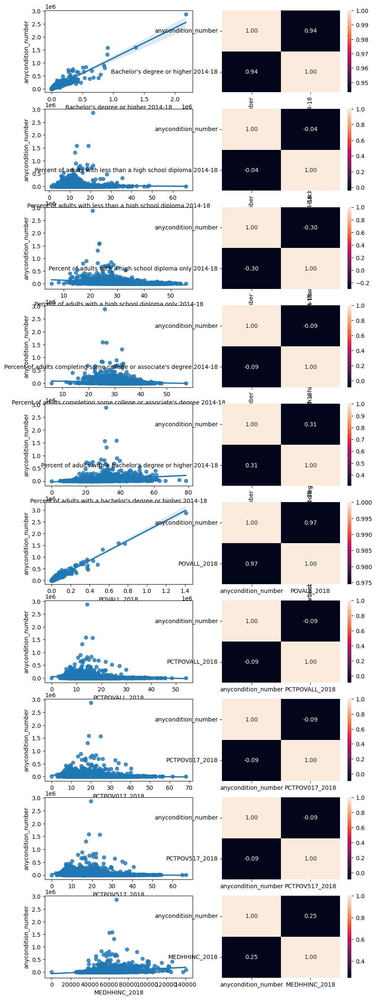

C:\Users\mamen\AppData\Local\Temp\ipykernel_20780\4018811909.py:16: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


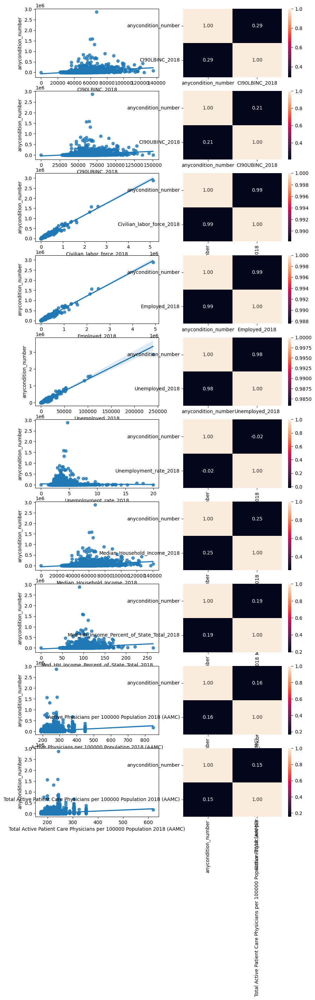

C:\Users\mamen\AppData\Local\Temp\ipykernel_20780\4018811909.py:16: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


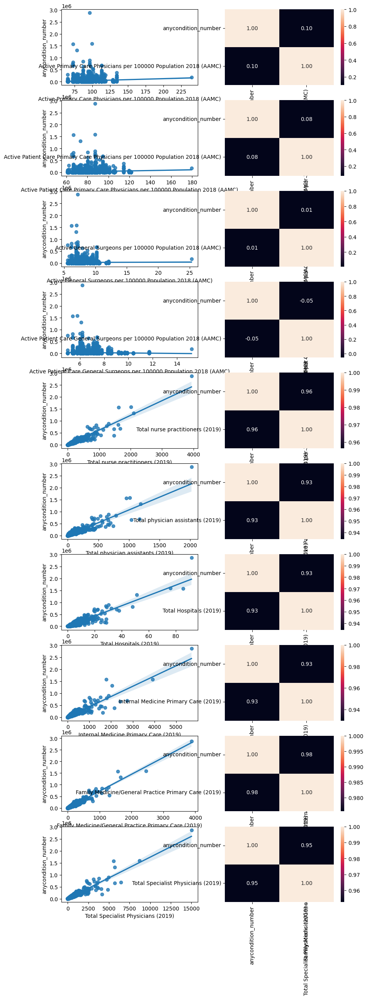

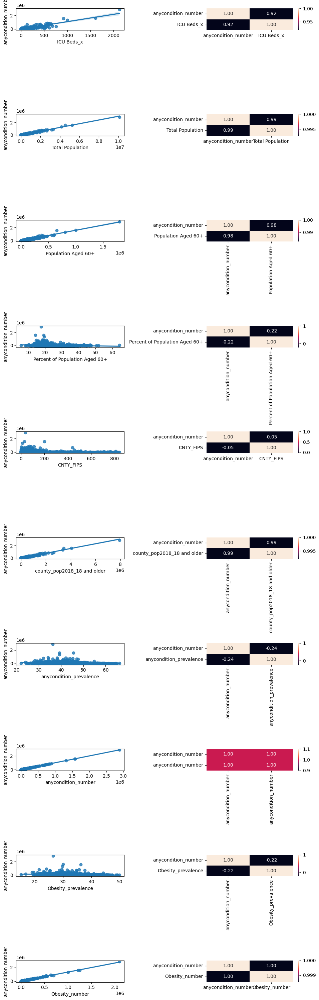

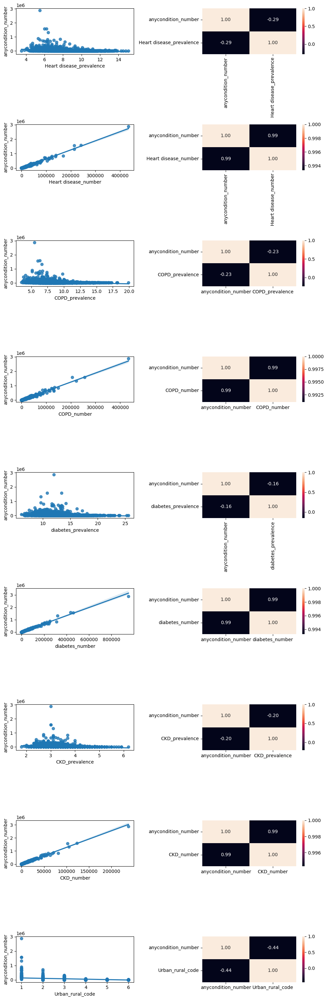

In [105]:
page_size = 10  # Máximo de gráficos por página
num_vars = len(column_filter)
num_pages = int(np.ceil(num_vars / page_size))
# Automatizado para solo filtrar los numericos a numericos y excluir que se compare el objetivo o clase a predecir, es decir, target consigo mismo
if(target):
    for page in range(num_pages):
        start = page * page_size
        end = min(start + page_size, num_vars)
        
        fig, axis = plt.subplots(end-start, 2, figsize=(10, min(7*(end-start), 30)), squeeze=False)

        for i, col in enumerate(column_filter[start:end]):
            sns.regplot(ax=axis[i, 0], data=data, x=col, y=target)
            sns.heatmap(data[[target, col]].corr(), annot=True, fmt=".2f", ax=axis[i, 1], cbar=True)

        plt.tight_layout()
        plt.show()
else:
    print(f"target {target} está vacío, se debe especificar el target para poder representar.")

- Alta correlación: Superior a 0,7 tanto positivo como negativo:TOT_POP,0-9, 19-Oct,20-29,30-39,40-49,50-59,60-69,70-79,80+,White-alone pop,
Black-alone pop,Native American/American Indian-alone pop, Asian-alone pop,Two or more races pop,POP_ESTIMATE_2018,
GQ_ESTIMATES_2018, Less than a high school diploma 2014-18, High school diploma only 2014-18, 
Some college or associate's degree 2014-18, Bacherlor's degree or higher 2014-18, POVALL_2018, Civilian_labor_force_2018,
Employed_2018,Unemployed_2018, Total nurse practitioners (2019), Total physician assistants (2019),
Total Hospitals (2019),Internal Medicine Primary Care (2019), Family Medicine/General Practice Primary Care (2019),
Total Specialist Physicians (2019), ICU Beds_x, Total Population, Population Aged 60+, county_pop2018_18 and older,
Obesity_number, Heart disease_number, COPD_number, diabetes_number, CKD_number
- Correlación Moderada: Entre 0,4 y 0,7 tanto positivo como negativo: % Asian-alone, Hawaiian/Pacific Islander-alone pop, N_POP_CHG_2018, Urban_rural_code
- Baja Correlación: Menor de 0,4 tanto positivo como negativo: El resto de predictoras

#### Análisis categórico-categórico 

In [106]:
categorical_variable

['Urban_rural_code', 'COUNTY_NAME', 'STATE_NAME']

In [107]:
if(target):
    if(pd.api.types.is_numeric_dtype(data[target])):    # es numérico
        print("El target es numérico y por tanto no es necesario hacer el análisis categórico-categórico")
    else:
        n_rows = (len(categorical_variable)+2) // 3 + 1
        n_cols = 3
        fig, axis = plt.subplots(n_rows, n_cols, figsize = (15, n_rows*5))
        category_counts = data[col].value_counts() # Contar las categorías en la columna.
            
        # Crear un histograma de cada variable categórica predictora con la variable target categórica
        for i,col in enumerate(categorical_variable):
            idx = i // n_cols
            j = i % 3
            sns.countplot(ax=axis[idx,j], data = data, x = col, hue = target)
            #Mostrar etiquetas del eje x para mejorar la legibilidad
            axis[idx, j].tick_params(axis='x', rotation=75)
        # Eliminar subgráficos vacíos (si los hay)
        for i in range(len(categorical_variable), n_rows*n_cols):
            idx = i // n_cols  # Fila vacía
            j = i % n_cols   # Columna vacía
            fig.delaxes(axis[idx][j])
        # Ajustar el layout
        plt.tight_layout()

        # Mostrar el plot
        plt.show()

else:
    print(f"target {target} está vacío, se debe especificar el target para poder representar.")


El target es numérico y por tanto no es necesario hacer el análisis categórico-categórico


In [108]:
data.columns

Index(['TOT_POP', '0-9', '0-9 y/o % of total pop', '19-Oct',
       '10-19 y/o % of total pop', '20-29', '20-29 y/o % of total pop',
       '30-39', '30-39 y/o % of total pop', '40-49',
       '40-49 y/o % of total pop', '50-59', '50-59 y/o % of total pop',
       '60-69', '60-69 y/o % of total pop', '70-79',
       '70-79 y/o % of total pop', '80+', '80+ y/o % of total pop',
       'White-alone pop', '% White-alone', 'Black-alone pop', '% Black-alone',
       'Native American/American Indian-alone pop', '% NA/AI-alone',
       'Asian-alone pop', '% Asian-alone',
       'Hawaiian/Pacific Islander-alone pop', '% Hawaiian/PI-alone',
       'Two or more races pop', '% Two or more races', 'POP_ESTIMATE_2018',
       'N_POP_CHG_2018', 'GQ_ESTIMATES_2018', 'R_birth_2018', 'R_death_2018',
       'R_NATURAL_INC_2018', 'Less than a high school diploma 2014-18',
       'High school diploma only 2014-18',
       'Some college or associate's degree 2014-18',
       'Bachelor's degree or higher 201

##### Combinaciones de la clase con varias predictoras

In [109]:
# DESACTIVAR CUANDO YA LO TIENES DEFINIDO
# factors_associated_target = input("Introduce todas las variables predictoras separados por comas que consideres que pueden estar relacionadas con el target")
# factors_associated_target = [x.strip() for x in factors_associated_target.split(",")]

In [110]:
categorical_variable

['Urban_rural_code', 'COUNTY_NAME', 'STATE_NAME']

In [111]:
factors_associated_target

[]

In [112]:
# fig, axis = plt.subplots(figsize = (5, 10), nrows = 3)

# sns.barplot(ax = axis[0], data = data, x = "neighbourhood_group", y = target, hue = "availability_365")
# sns.barplot(ax = axis[1], data = data, x = "neighbourhood", y = target, hue = "availability_365")
# sns.barplot(ax = axis[2], data = data, x = "room_type", y = target, hue = "availability_365")

# plt.tight_layout()

# plt.show()

In [113]:
# GENERO LAS GRÁFICAS DEL TARGET CON VARIAS PREDICTORAS Y CON AQUELLA QUE SE CONSIDERA SUBJETIVAMENTE QUE PUEDE SER INTERESANTE
import time
relevant_variables = ['TOT_POP','0-9', '19-Oct','20-29','30-39','40-49','50-59','60-69','70-79','80+','White-alone pop',
'Black-alone pop','Native American/American Indian-alone pop', 'Asian-alone pop','Two or more races pop','POP_ESTIMATE_2018',
'GQ_ESTIMATES_2018', 'Less than a high school diploma 2014-18', 'High school diploma only 2014-18', 
"Some college or associate's degree 2014-18, Bacherlor's degree or higher 2014-18", 'POVALL_2018', 'Civilian_labor_force_2018',
'Employed_2018','Unemployed_2018', 'Total nurse practitioners (2019)', 'Total physician assistants (2019)',
'Total Hospitals (2019)','Internal Medicine Primary Care (2019)', 'Family Medicine/General Practice Primary Care (2019)',
'Total Specialist Physicians (2019)', 'ICU Beds_x', 'Total Population', 'Population Aged 60+', 'county_pop2018_18 and older',
'Obesity_number', 'Heart disease_number', 'COPD_number', 'diabetes_number', 'CKD_number']
if(categorical_variable and factors_associated_target):
    start_time = time.time()
    # Generar combinaciones de gráficos entre las variables categóricas y los factores asociados al target
    combinations = list(itertools.product(relevant_variables, factors_associated_target))

    # Separar las combinaciones en impares y pares
    # combinations_odd = combinations[::2]  # Combinaciones pares
    # combinations_even = combinations[1::2]  # Combinaciones impares

    # Crear la figura con suficiente espacio para los subgráficos (evitar llamar a plt.subplots repetidamente)
    fig, axis = plt.subplots(len(combinations), 1, figsize=(8, 5*len(combinations)))

    # Asegurarse de que 'axis' sea un arreglo 1D
    axis = axis.flatten() if isinstance(axis, np.ndarray) and axis.ndim > 1 else axis

    end_time = time.time()
    # Graficar todas las combinaciones en un solo bucle (sin dividir en pares e impares)
    for i, (col, factor) in enumerate(combinations):
        data[factor] = data[factor].astype('category')
        sns.barplot(ax=axis[i], data=data, x=col, y=target, hue=factor)
        axis[i].set_title(f'Barplot de {col} y {factor}')
        #categories = data[factor].unique()
        axis[i].legend(loc="upper right")
        #Mostrar etiquetas del eje x para mejorar la legibilidad
        axis[i].tick_params(axis='x', rotation=75)
    print(f"tiempo:{end_time - start_time}")
    plt.tight_layout()
    plt.show()

elif(categorical_variable):
    print("categorical_variable está vacío, debe llenarse para poder representarse")
else:
    print("factors_associated_target está vacío, debe llenarse para poder representarse")

categorical_variable está vacío, debe llenarse para poder representarse


Como se ha mencionado anteriormente, existe una correlación muy alta con:
TOT_POP,0-9, 19-Oct,20-29,30-39,40-49,50-59,60-69,70-79,80+,White-alone pop,
Black-alone pop,Native American/American Indian-alone pop, Asian-alone pop,Two or more races pop,POP_ESTIMATE_2018,
GQ_ESTIMATES_2018, Less than a high school diploma 2014-18, High school diploma only 2014-18, 
Some college or associate's degree 2014-18, Bacherlor's degree or higher 2014-18, POVALL_2018, Civilian_labor_force_2018,
Employed_2018,Unemployed_2018, Total nurse practitioners (2019), Total physician assistants (2019),
Total Hospitals (2019),Internal Medicine Primary Care (2019), Family Medicine/General Practice Primary Care (2019),
Total Specialist Physicians (2019), ICU Beds_x, Total Population, Population Aged 60+, county_pop2018_18 and older,
Obesity_number, Heart disease_number, COPD_number, diabetes_number, CKD_number

##### Análisis de correlaciones

In [114]:
import json
categorical_variable_list = []

for cat in categorical_variable:

  data[f"{cat}_n"] = pd.factorize(data[cat])[0]
  categorical_variable_list.append(f"{cat}_n")
  transformation_rules = {str(row[cat]): int(row[f"{cat}_n"]) for _, row in data[[cat, f"{cat}_n"]].drop_duplicates().iterrows()}

  with open(os.path.join(path_config,f"{cat}_transformation_rules.json"), "w") as f:
    json.dump(transformation_rules, f)

# ----------------------------------------------------------------------------------
# EN PRODUCCIÓN (CUANDO HAYÁIS ENTRENADO EL MODELO Y OS LLEGUEN DATOS NUEVOS) HACÉIS:
# 
# with open("Sport_transformation_rules.json", "r") as f:
#   Sport_transformation_rules = json.load(f)

# data["Sport_n"] = data["Sport"].apply(lambda x: Sport_transformation_rules[x])



In [115]:
data

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
0,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,...,8.6,3644,12.9,5462,3.1,1326,3,0,0,0
1,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,...,8.6,14692,12.0,20520,3.2,5479,4,1,1,0
2,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,...,12.1,2373,19.7,3870,4.5,887,6,2,2,0
3,22400,2456,10.964286,2596,11.589286,3029,13.522321,3113,13.897321,3038,...,10.0,1789,14.1,2511,3.3,595,2,3,3,0
4,57840,7095,12.266598,7570,13.087828,6742,11.656293,6884,11.901798,7474,...,10.5,4661,13.5,6017,3.4,1507,2,3,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,43051,6104,14.178532,6326,14.694200,5359,12.448027,6577,15.277229,5334,...,6.6,2098,8.9,2834,2.6,821,5,4,1837,50
3136,23081,2384,10.328842,2185,9.466661,2967,12.854729,4093,17.733200,3423,...,4.9,928,7.2,1360,2.4,447,5,4,481,50
3137,20299,3121,15.375142,3205,15.788955,2153,10.606434,2702,13.311001,2390,...,8.0,1163,10.4,1500,3.0,430,5,4,1838,50
3138,7885,858,10.881420,1113,14.115409,715,9.067850,903,11.452124,900,...,8.3,506,11.3,686,3.4,207,6,2,1839,50


Análisis de correlación de variables categóricas

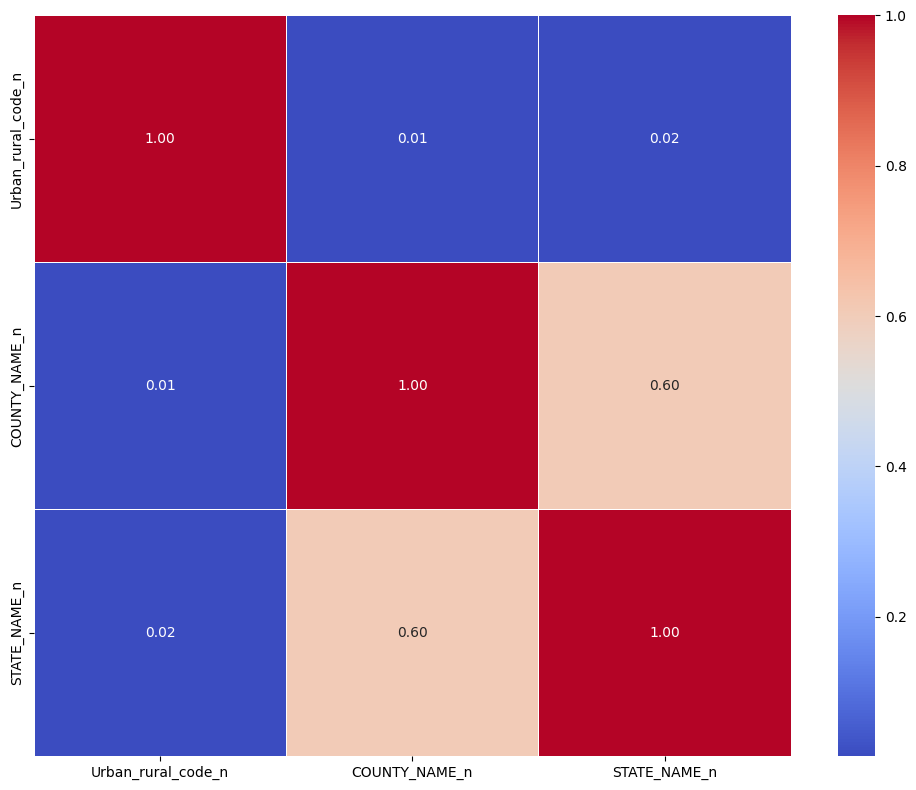

In [116]:
    
corr_matrix = data[categorical_variable_list].corr()
plt.figure(figsize=(10, 8))  
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)

plt.tight_layout()

plt.show()

El análisis de correlaciones categóricas se puede desglosar en aquellas que presentan una correlación positiva y aquellas que presentan una correlación negativa. 

* Respecto a las correlaciones positivas se observa una gran correlación entre STATE_NAME_n y COUNTY_NAME_n (del 60%), tiene lógica dicha correlación.

Finalmente, para cerrar el estudio multivariante queda analizar la relación entre las variables categóricas y numéricas.

#### Análisis numérico-categórico (completo)

In [117]:
# FUNCIONA CUANDO LA MATRIZ ES PEQUEÑA
# corr_matrix = data.select_dtypes(include=['number']).corr()

# plt.figure(figsize=(10, 8))  
# sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)

# plt.tight_layout()

# plt.show()

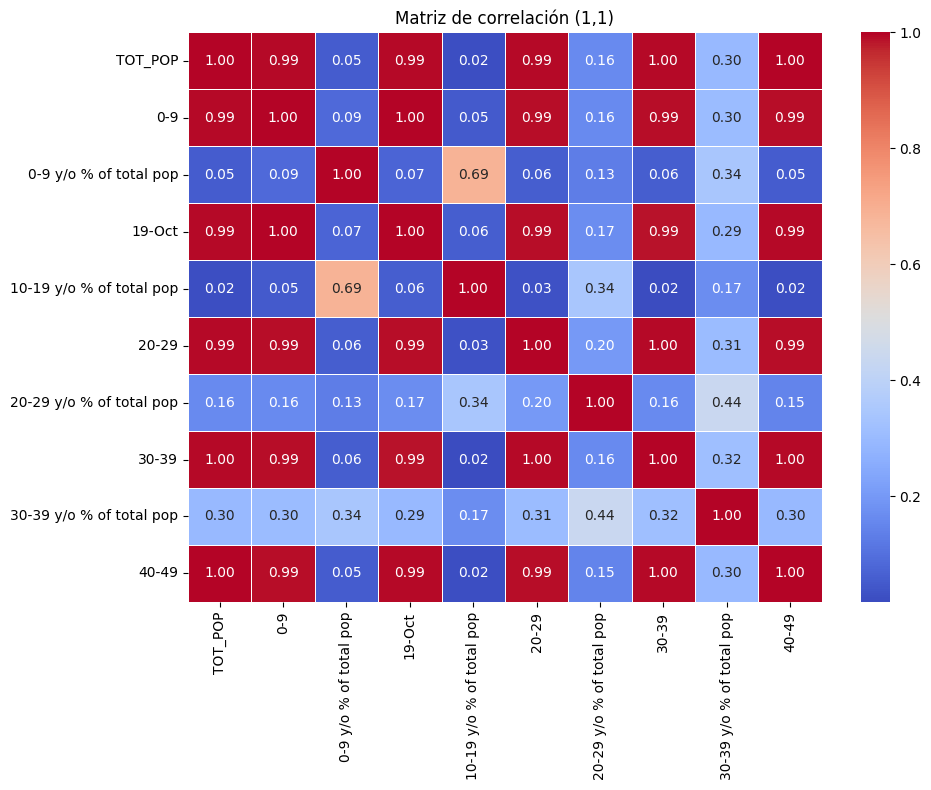

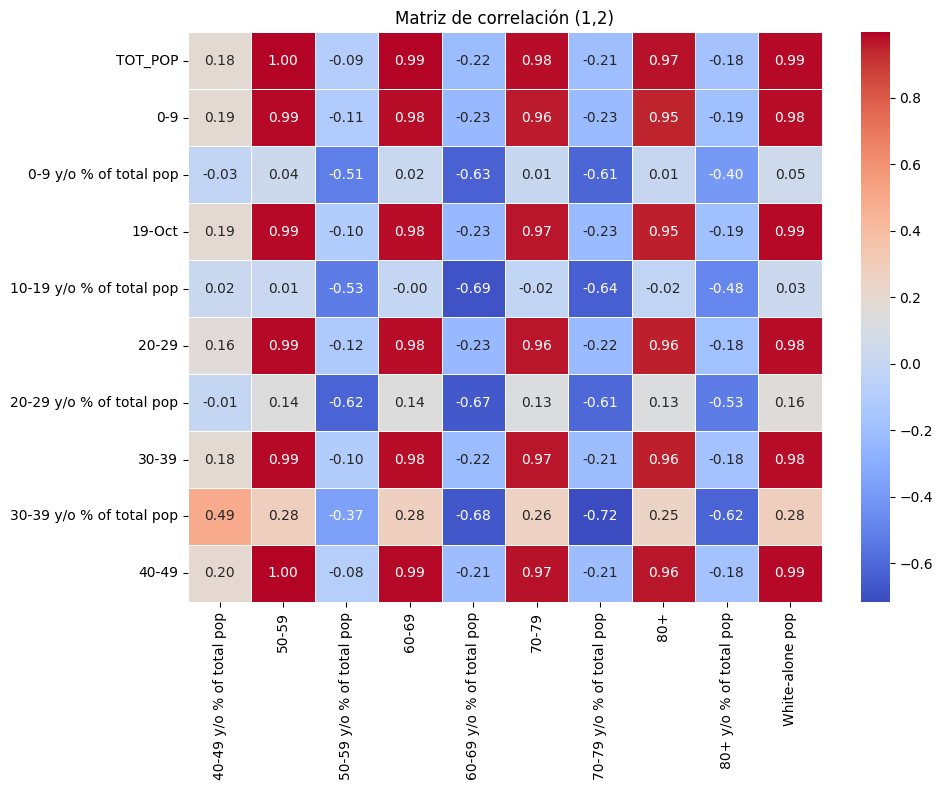

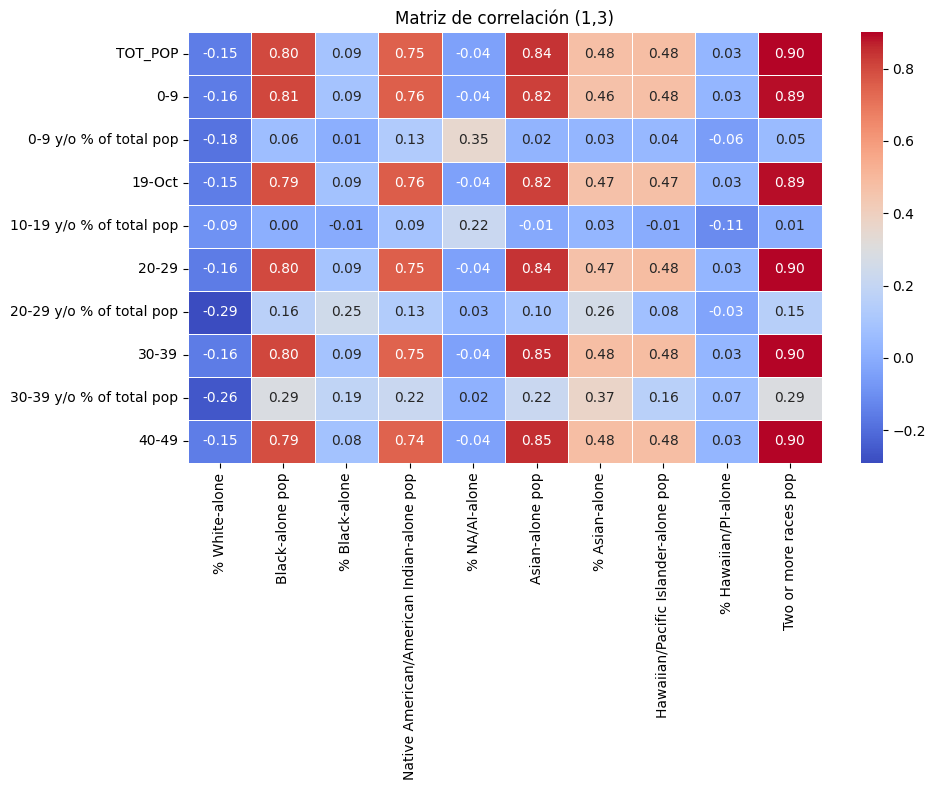

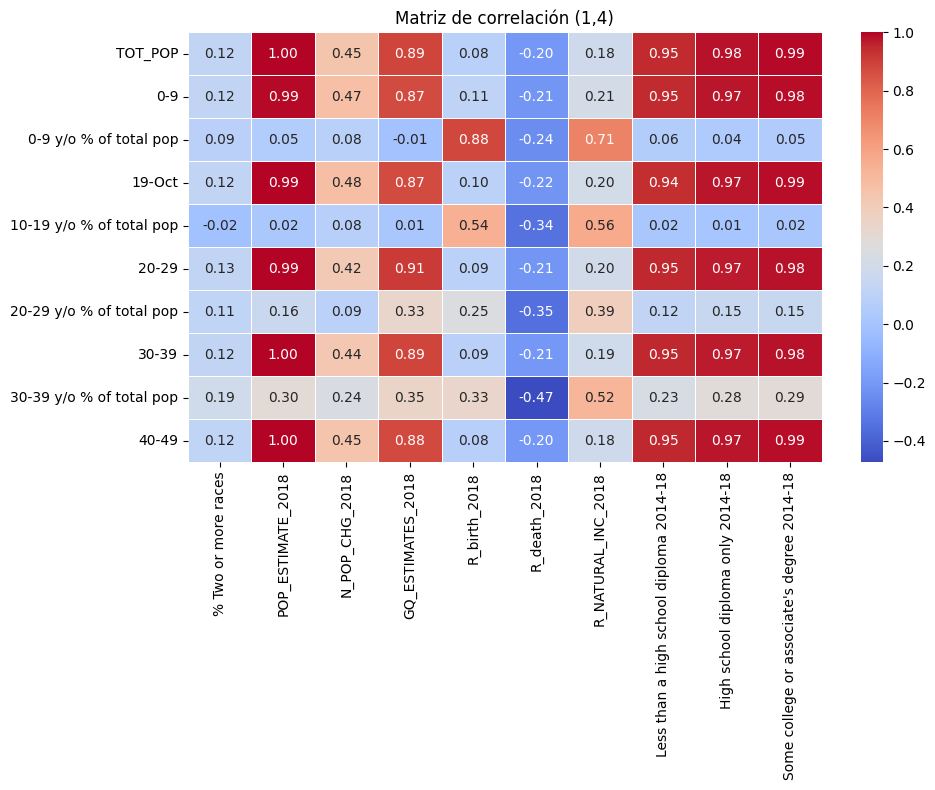

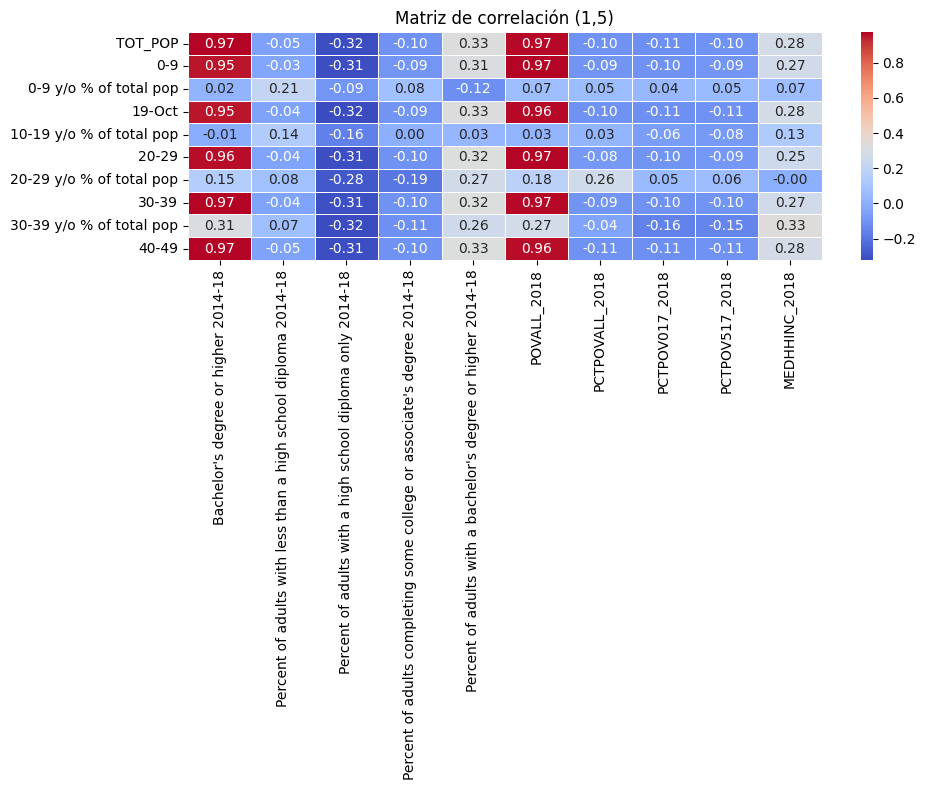

...

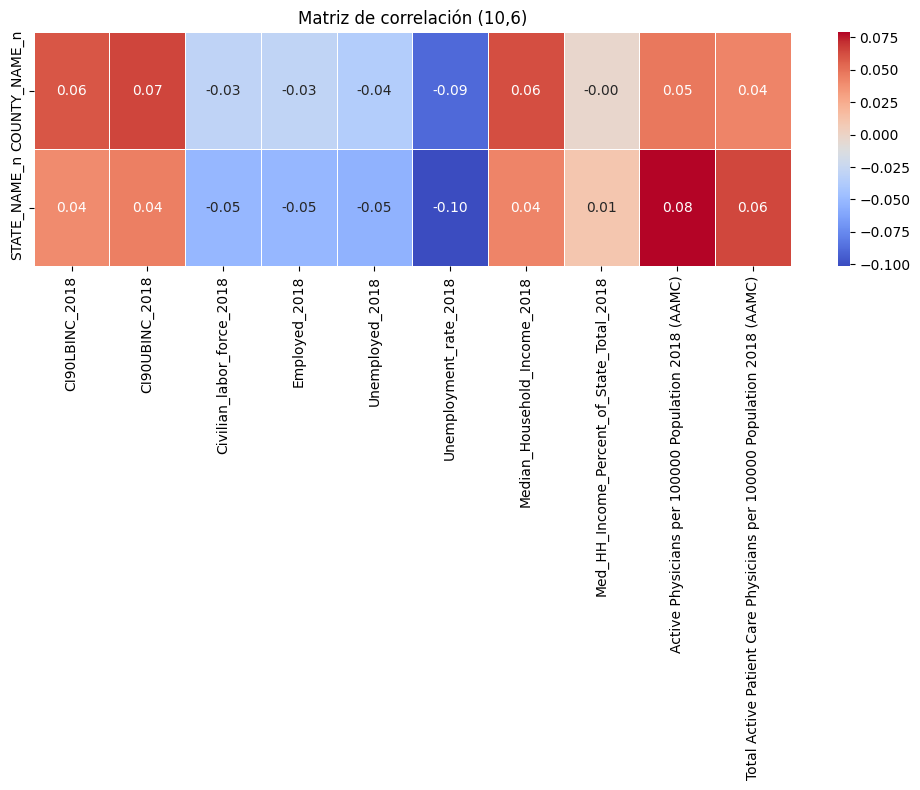

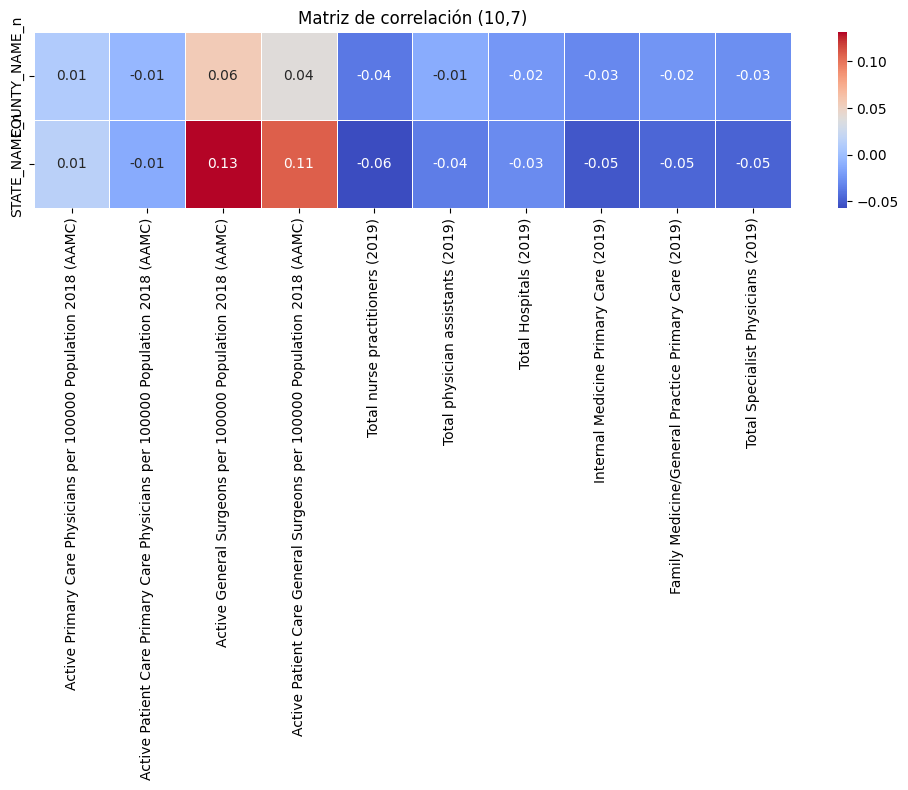

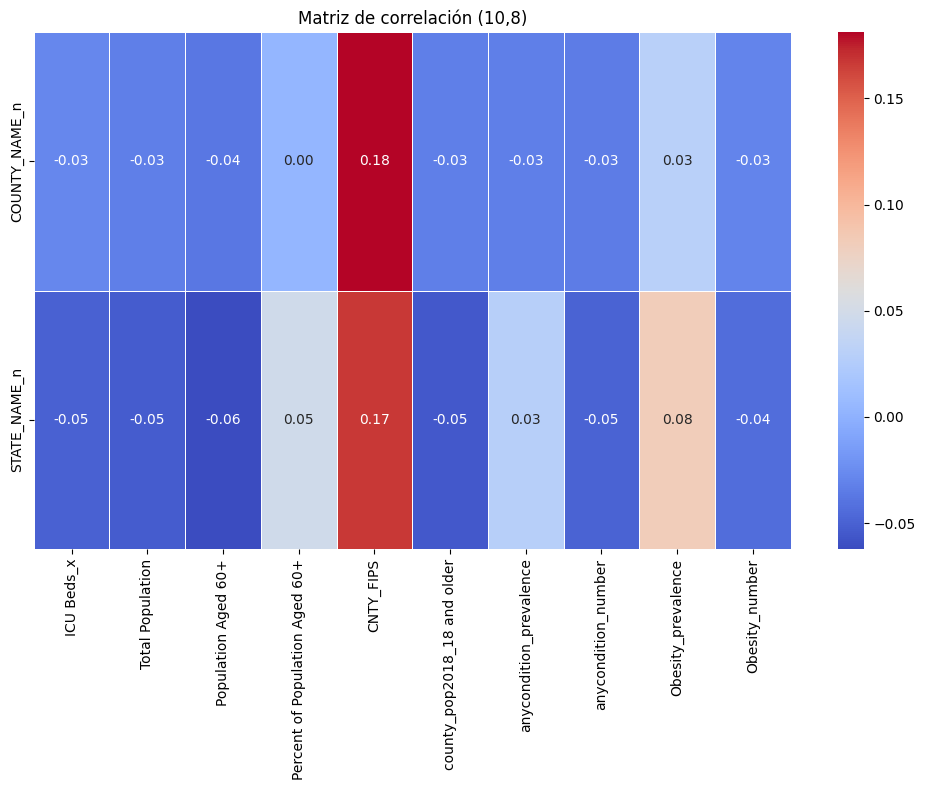

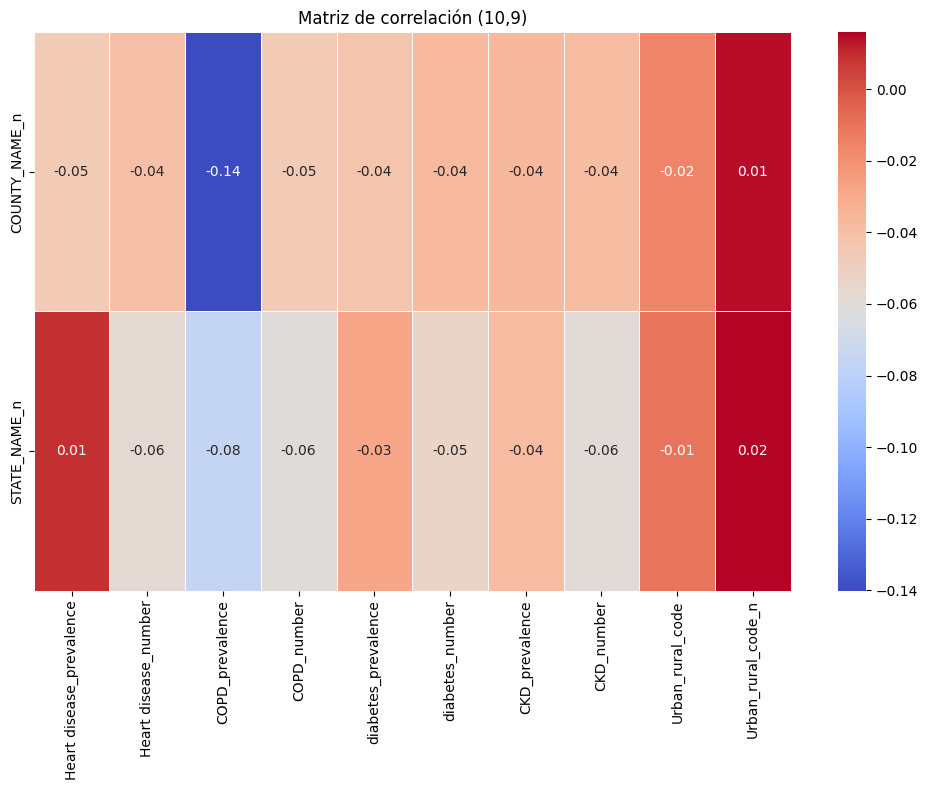

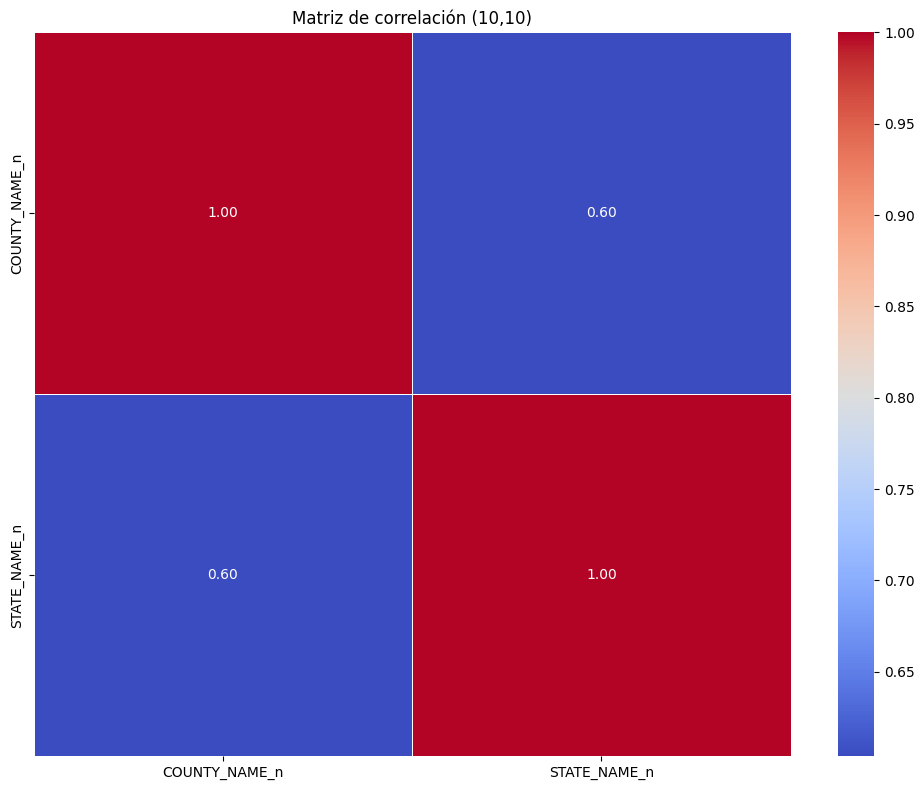

In [118]:
# FUNCIONA CUANDO LA MATRIZ ES ENORME
# Obtener matriz de correlación solo con variables numéricas
corr_matrix = data.select_dtypes(include=['number']).corr()

# Tamaño del bloque en cada página
page_size = 10  
num_vars = len(corr_matrix)
num_pages = int(np.ceil(num_vars / page_size))  # Número total de páginas en cada dirección

# Iterar sobre bloques de filas
for row_page in range(num_pages):
    row_start = row_page * page_size
    row_end = min(row_start + page_size, num_vars)

    # Iterar sobre bloques de columnas
    for col_page in range(num_pages):
        col_start = col_page * page_size
        col_end = min(col_start + page_size, num_vars)

        # Extraer la submatriz de correlación para esta página
        sub_corr_matrix = corr_matrix.iloc[row_start:row_end, col_start:col_end]

        # Graficar el heatmap de la submatriz
        plt.figure(figsize=(10, 8))
        sns.heatmap(sub_corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)

        plt.title(f'Matriz de correlación ({row_page+1},{col_page+1})')
        plt.tight_layout()
        plt.show()

In [119]:
# CUANDO SEA UNA MATRIZ DE CORRELACIÓN MEDIA
# # Calcular la matriz de correlación solo con columnas numéricas
# corr_matrix = data.select_dtypes(include=['number']).corr()

# # Obtener la cantidad de columnas y dividir en dos grupos
# num_cols = len(corr_matrix.columns)
# mid_point = num_cols // 2  # Punto medio para dividir

# cols_1 = corr_matrix.columns[:mid_point]  # Primera mitad
# cols_2 = corr_matrix.columns[mid_point:]  # Segunda mitad

# # Crear dos figuras separadas
# fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# # Heatmap de la primera mitad de columnas
# sns.heatmap(corr_matrix.loc[cols_1, cols_1], annot=False, fmt=".2f", cmap="coolwarm", linewidths=0.5, ax=axes[0])
# axes[0].set_title("Matriz de correlación - Parte 1")

# # Heatmap de la segunda mitad de columnas
# sns.heatmap(corr_matrix.loc[cols_2, cols_2], annot=False, fmt=".2f", cmap="coolwarm", linewidths=0.5, ax=axes[1])
# axes[1].set_title("Matriz de correlación - Parte 2")

# # Ajustar diseño
# plt.tight_layout()

# # Mostrar los gráficos
# plt.show()

In [120]:
data.columns

Index(['TOT_POP', '0-9', '0-9 y/o % of total pop', '19-Oct',
       '10-19 y/o % of total pop', '20-29', '20-29 y/o % of total pop',
       '30-39', '30-39 y/o % of total pop', '40-49',
       '40-49 y/o % of total pop', '50-59', '50-59 y/o % of total pop',
       '60-69', '60-69 y/o % of total pop', '70-79',
       '70-79 y/o % of total pop', '80+', '80+ y/o % of total pop',
       'White-alone pop', '% White-alone', 'Black-alone pop', '% Black-alone',
       'Native American/American Indian-alone pop', '% NA/AI-alone',
       'Asian-alone pop', '% Asian-alone',
       'Hawaiian/Pacific Islander-alone pop', '% Hawaiian/PI-alone',
       'Two or more races pop', '% Two or more races', 'POP_ESTIMATE_2018',
       'N_POP_CHG_2018', 'GQ_ESTIMATES_2018', 'R_birth_2018', 'R_death_2018',
       'R_NATURAL_INC_2018', 'Less than a high school diploma 2014-18',
       'High school diploma only 2014-18',
       'Some college or associate's degree 2014-18',
       'Bachelor's degree or higher 201

***



Se decide comentar el pairplot ya que en este caso no va a aportar valor.

In [121]:
#sns.pairplot(data = data)

### Paso 5: Ingeniería de características

#### Análisis de outliers

In [122]:
data.describe()

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
count,3.140000e+03,3.140000e+03,3140.000000,3.140000e+03,3140.000000,3.140000e+03,3140.000000,3.140000e+03,3140.000000,3.140000e+03,...,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000,3140.000000
mean,1.041894e+05,1.274030e+04,11.871051,1.336798e+04,12.694609,1.446933e+04,12.283979,1.391649e+04,11.751535,1.288521e+04,...,9.095223,5827.242357,13.073503,9326.577707,3.446242,2466.234076,4.635350,2.239490,688.478981,26.253503
std,3.335834e+05,4.180730e+04,2.124081,4.228439e+04,1.815044,4.957773e+04,3.126297,4.899095e+04,1.696599,4.347219e+04,...,2.344965,15720.551934,2.724351,29754.601185,0.568059,7730.422067,1.510447,1.288306,541.767733,14.260381
min,8.800000e+01,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000,1.100000e+01,6.092789,4.000000e+00,...,3.500000,7.000000,6.100000,11.000000,1.800000,3.000000,1.000000,0.000000,0.000000,0.000000
25%,1.096325e+04,1.280500e+03,10.594639,1.374500e+03,11.674504,1.263750e+03,10.496774,1.232750e+03,10.689322,1.245250e+03,...,7.300000,815.000000,11.200000,1187.750000,3.100000,314.750000,3.000000,2.000000,182.000000,14.000000
50%,2.580050e+04,3.057000e+03,11.802727,3.274000e+03,12.687422,3.108000e+03,11.772649,3.000500e+03,11.580861,3.048500e+03,...,8.900000,1963.500000,12.800000,2743.000000,3.400000,718.000000,5.000000,2.000000,564.000000,25.000000
75%,6.791300e+04,8.097000e+03,12.951840,8.822250e+03,13.659282,8.976250e+03,13.182260,8.314250e+03,12.639379,8.120500e+03,...,10.600000,4727.000000,14.800000,6679.250000,3.800000,1776.250000,6.000000,3.000000,1129.250000,40.000000
max,1.010552e+07,1.208253e+06,25.460677,1.239139e+06,23.304372,1.557073e+06,37.570198,1.501844e+06,22.225129,1.350076e+06,...,19.900000,434075.000000,25.600000,952335.000000,6.200000,237766.000000,6.000000,5.000000,1840.000000,50.000000


In [123]:
columns_number = data.select_dtypes(include='number')

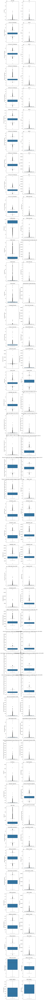

In [124]:
# Separar los gráficos en impares y pares
columns_odd = [col for i, col in enumerate(columns_number) if i % 2 != 0]  # Gráficos con índice impar (1, 3, 5,...)
columns_even = [col for i, col in enumerate(columns_number) if i % 2 == 0]  # Gráficos con índice par (0, 2, 4,...)

# Número de filas necesarias (igual a la cantidad máxima de gráficos en ambos grupos)
num_rows = max(len(columns_odd), len(columns_even))

# Crear la figura y los subgráficos
fig, axis = plt.subplots(num_rows, 2, figsize=(8, 5*num_rows))

# Graficar los gráficos impares (a la izquierda)
for i, col in enumerate(columns_even):
    sns.boxplot(ax=axis[i, 0], data=data, y=col)
    axis[i, 0].set_title(col)

# Graficar los gráficos pares (a la derecha)
for i, col in enumerate(columns_odd):
    sns.boxplot(ax=axis[i, 1], data=data, y=col)
    axis[i, 1].set_title(col)

# sns.boxplot(ax = axis[0, 1], data = data, y = "minimum_nights")
# sns.boxplot(ax = axis[0, 2], data = data, y = "number_of_reviews")
# sns.boxplot(ax = axis[1, 0], data = data, y = "reviews_per_month")
# sns.boxplot(ax = axis[1, 1], data = data, y = "calculated_host_listings_count")
# sns.boxplot(ax = axis[1, 2], data = data, y = "availability_365")
# sns.boxplot(ax = axis[2, 0], data = data, y = "neighbourhood_group_n")
# sns.boxplot(ax = axis[2, 1], data = data, y = "room_type_n")
# sns.boxplot(ax = axis[2, 2], data = data, y = "neighbourhood_n")

plt.tight_layout()

plt.show()

In [125]:
data.select_dtypes(include='number').columns

Index(['TOT_POP', '0-9', '0-9 y/o % of total pop', '19-Oct',
       '10-19 y/o % of total pop', '20-29', '20-29 y/o % of total pop',
       '30-39', '30-39 y/o % of total pop', '40-49',
       '40-49 y/o % of total pop', '50-59', '50-59 y/o % of total pop',
       '60-69', '60-69 y/o % of total pop', '70-79',
       '70-79 y/o % of total pop', '80+', '80+ y/o % of total pop',
       'White-alone pop', '% White-alone', 'Black-alone pop', '% Black-alone',
       'Native American/American Indian-alone pop', '% NA/AI-alone',
       'Asian-alone pop', '% Asian-alone',
       'Hawaiian/Pacific Islander-alone pop', '% Hawaiian/PI-alone',
       'Two or more races pop', '% Two or more races', 'POP_ESTIMATE_2018',
       'N_POP_CHG_2018', 'GQ_ESTIMATES_2018', 'R_birth_2018', 'R_death_2018',
       'R_NATURAL_INC_2018', 'Less than a high school diploma 2014-18',
       'High school diploma only 2014-18',
       'Some college or associate's degree 2014-18',
       'Bachelor's degree or higher 201

In [126]:
import json

total_data_con_outliers = data.copy()
total_data_sin_outliers = data.copy()
def convert_to_standard_types(obj):
  if isinstance(obj, np.int64):  # Convertir numpy.int64 a int
      return int(obj)
  elif isinstance(obj, np.float64):  # Convertir numpy.float64 a float
      return float(obj)
  
def replace_outliers_from_column(column, df):
  column_stats = df[column].describe()
  
  column_iqr = column_stats["75%"] - column_stats["25%"]
  # print("Column IQR:",column_iqr)
  # print("25%:",column_stats["25%"])
  upper_limit = column_stats["75%"] + 1.5 * column_iqr
  lower_limit = column_stats["25%"] - 1.5 * column_iqr
  lower_limit = max(df[column].min(),lower_limit)
  #print(lower_limit)
  
  # Remove upper outliers
  df[column] = df[column].apply(lambda x: x if (x <= upper_limit) else upper_limit)
  # Remove lower outliers
  df[column] = df[column].apply(lambda x: x if (x >= lower_limit) else lower_limit)
  
  return df.copy(), [lower_limit, upper_limit]
def replace_outliers_from_column_with_clip(column, df):
  column_stats = df[column].describe()
  
  column_iqr = column_stats["75%"] - column_stats["25%"]
  # print("Column IQR:",column_iqr)
  # print("25%:",column_stats["25%"])
  upper_limit = column_stats["75%"] + 1.5 * column_iqr
  lower_limit = column_stats["25%"] - 1.5 * column_iqr
  lower_limit = max(df[column].min(),lower_limit)
  # print(lower_limit)
  
  # Remove upper outliers
  df[column] = df[column].clip(lower=lower_limit, upper=upper_limit)
  
  
  return df.copy(), [lower_limit, upper_limit]
outliers_dict = {}
for column in columns_number:
  total_data_sin_outliers, limits_list = replace_outliers_from_column(column, total_data_sin_outliers)
  outliers_dict[column] = limits_list

outliers_dict_standard = convert_to_standard_types(outliers_dict)

with open(path_config+"/outliers_replacement.json", "w") as f:
  json.dump(outliers_dict_standard, f)
outliers_dict

{'TOT_POP': [np.int64(88), np.float64(153337.625)],
 '0-9': [np.int64(0), np.float64(18321.75)],
 '0-9 y/o % of total pop': [np.float64(7.0588377662499955),
  np.float64(16.487640596250003)],
 '19-Oct': [np.int64(0), np.float64(19993.875)],
 '10-19 y/o % of total pop': [np.float64(8.697336139999999),
  np.float64(16.63644994)],
 '20-29': [np.int64(0), np.float64(20545.0)],
 '20-29 y/o % of total pop': [np.float64(6.468544207500002),
  np.float64(17.2104902675)],
 '30-39': [np.int64(11), np.float64(18936.5)],
 '30-39 y/o % of total pop': [np.float64(7.7642376849999994),
  np.float64(15.564463085000002)],
 '40-49': [np.int64(4), np.float64(18433.375)],
 '40-49 y/o % of total pop': [np.float64(8.133868276249999),
  np.float64(14.937412626250001)],
 '50-59': [np.int64(14), np.float64(20668.625)],
 '50-59 y/o % of total pop': [np.float64(10.202730187500004),
  np.float64(16.964945307499995)],
 '60-69': [np.int64(20), np.float64(19561.5)],
 '60-69 y/o % of total pop': [np.float64(7.352197581

In [127]:
total_data_sin_outliers.dtypes

TOT_POP                     float64
0-9                         float64
0-9 y/o % of total pop      float64
19-Oct                      float64
10-19 y/o % of total pop    float64
                             ...   
CKD_number                  float64
Urban_rural_code              int64
Urban_rural_code_n          float64
COUNTY_NAME_n                 int64
STATE_NAME_n                  int64
Length: 94, dtype: object

In [128]:
total_data_con_outliers.isnull().sum().sort_values(ascending=False)

TOT_POP                     0
0-9                         0
0-9 y/o % of total pop      0
19-Oct                      0
10-19 y/o % of total pop    0
                           ..
CKD_number                  0
Urban_rural_code            0
Urban_rural_code_n          0
COUNTY_NAME_n               0
STATE_NAME_n                0
Length: 94, dtype: int64

In [129]:
columns_na_con_outliers = total_data_con_outliers.loc[:,total_data_con_outliers.isnull().any()].columns



In [130]:
total_data_sin_outliers.isnull().sum().sort_values(ascending=False)

TOT_POP                     0
0-9                         0
0-9 y/o % of total pop      0
19-Oct                      0
10-19 y/o % of total pop    0
                           ..
CKD_number                  0
Urban_rural_code            0
Urban_rural_code_n          0
COUNTY_NAME_n               0
STATE_NAME_n                0
Length: 94, dtype: int64

In [131]:
columns_na_sin_outliers = total_data_sin_outliers.loc[:,total_data_sin_outliers.isnull().any()].columns

In [132]:
def replace_na_with_mean(columns_na_outliers, total_data, con_outliers="con"):
    total_data = total_data.copy()
    for na_outlier in columns_na_outliers:
        if na_outlier in total_data.columns:    # si la columna no está en el DF
            total_data[na_outlier] = total_data[na_outlier].fillna(
                total_data[na_outlier].mean()
            )
        else:
            print("La columna no se encuentra en el DataFrame: Revisa que tiene los nombres correctos")
    print(f"Se han rellenado los NAs en total_data_{con_outliers}_outliers")
    return total_data

if(not columns_na_con_outliers.empty):
    total_data_con_outliers = replace_na_with_mean(columns_na_con_outliers,total_data=total_data_con_outliers)
if(not columns_na_sin_outliers.empty):    
    total_data_sin_outliers = replace_na_with_mean(columns_na_sin_outliers, total_data=total_data_sin_outliers,con_outliers="sin")

In [133]:
total_data_con_outliers.isnull().sum()

TOT_POP                     0
0-9                         0
0-9 y/o % of total pop      0
19-Oct                      0
10-19 y/o % of total pop    0
                           ..
CKD_number                  0
Urban_rural_code            0
Urban_rural_code_n          0
COUNTY_NAME_n               0
STATE_NAME_n                0
Length: 94, dtype: int64

In [134]:
total_data_sin_outliers.isnull().sum()

TOT_POP                     0
0-9                         0
0-9 y/o % of total pop      0
19-Oct                      0
10-19 y/o % of total pop    0
                           ..
CKD_number                  0
Urban_rural_code            0
Urban_rural_code_n          0
COUNTY_NAME_n               0
STATE_NAME_n                0
Length: 94, dtype: int64

Vemos cómo los valores han sido imputados correctamente y ya no existen faltantes.

#### Inferencia de nuevas características

Otro uso típico en esta ingeniería es la de la obtención de nuevas características mediante la "fusión" de dos o más ya existentes. Uniendo estas dos variables y sumándolas/multiplicando/operación matemática/etc podemos obtener una tercera. En nuestro caso no lo hacemos ya que son variables que no se podría hacer dicha fusión. 

`¿Sería posible concatenar los números de aquellas categóricas? En principio si¿Habría que hacerlo en aquellas con una alta correlación entre sí? No tiene nada que ver con la correlación ¿se mantendrían el resto de variables de antes de la fusión? No se mantendrían`

In [135]:
total_data_con_outliers.sort_values(by=target ,ascending=False)

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
202,10105518,1208253,11.956369,1239139,12.262004,1557073,15.408146,1501844,14.861623,1350076,...,5.5,434075,12.0,952335,3.0,237766,1,5,184,4
608,5180493,627602,12.114716,623977,12.044742,769628,14.856269,783596,15.125896,657620,...,6.3,256526,10.8,436733,3.0,123364,1,5,364,13
2621,4698619,702806,14.957714,669768,14.254571,698435,14.864687,728164,15.497405,623867,...,6.0,205605,13.4,460821,3.0,102160,1,5,391,43
101,4410824,568892,12.897635,600600,13.616503,627348,14.222921,606358,13.747046,560407,...,6.6,222293,9.6,321467,3.1,105112,1,5,101,2
220,3343364,409094,12.235999,404237,12.090727,538232,16.098516,504704,15.095694,417723,...,5.1,133740,9.6,251137,2.7,70932,1,5,201,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1630,513,50,9.746589,55,10.721248,44,8.576998,47,9.161793,51,...,7.1,30,11.3,48,3.4,14,6,2,1049,26
1654,465,61,13.118280,70,15.053763,52,11.182796,51,10.967742,54,...,7.0,24,10.7,37,3.2,11,6,2,1065,27
2655,277,37,13.357401,37,13.357401,28,10.108303,37,13.357401,26,...,8.0,16,12.0,25,3.2,7,6,2,1582,43
2671,152,28,18.421053,28,18.421053,24,15.789474,26,17.105263,4,...,7.5,8,11.4,11,2.7,3,6,2,1591,43


In [136]:
# DEFINIR LA INFERENCIA DE LA NUEVA CARACTERÍSTICA [NECESARIO FACTOR HUMANO - OPCIONAL]]
# Inferencia de nuevas características




In [137]:
columns_drop = []


#### Escalado de valores

In [138]:
from sklearn.model_selection import train_test_split

#num_variables = total_data_con_outliers.select_dtypes(include='number').drop(columns=[target] + exclude_new_features).columns.to_list()
num_variables = total_data_con_outliers.select_dtypes(include='number').drop(columns=[target]+ columns_drop).columns.to_list()
# Dividimos el conjunto de datos en muestras de train y test
X_con_outliers = total_data_con_outliers.drop(columns=target, axis = 1)[num_variables]
X_sin_outliers = total_data_sin_outliers.drop(columns=target, axis = 1)[num_variables]
y = total_data_con_outliers[target]

X_train_con_outliers, X_test_con_outliers, y_train, y_test = train_test_split(X_con_outliers, y, test_size = 0.2, random_state = 42)
X_train_sin_outliers, X_test_sin_outliers = train_test_split(X_sin_outliers, test_size = 0.2, random_state = 42)



# GUARDAR LOS DATASETS
X_train_con_outliers.to_excel(os.path.join(current_dir,"../data/processed/X_train_con_outliers.xlsx"), index = False)
X_train_sin_outliers.to_excel(os.path.join(current_dir,"../data/processed/X_train_sin_outliers.xlsx"), index = False)
X_test_con_outliers.to_excel(os.path.join(current_dir,"../data/processed/X_test_con_outliers.xlsx"), index = False)
X_test_sin_outliers.to_excel(os.path.join(current_dir,"../data/processed/X_test_sin_outliers.xlsx"), index = False)
y_train.to_excel(os.path.join(current_dir,"../data/processed/y_train.xlsx"), index = False)
y_test.to_excel(os.path.join(current_dir,"../data/processed/y_test.xlsx"), index = False)

X_train_con_outliers.head()

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
1292,26625,3221,12.097653,3463,13.006573,2922,10.974648,2829,10.625352,2831,...,11.3,2314,13.7,2823,3.8,771,6,2,879,22
2302,51266,5272,10.283619,5751,11.217961,5137,10.020286,5341,10.418211,5880,...,9.9,4097,13.1,5416,3.5,1454,5,4,1404,38
761,37779,3915,10.362900,5118,13.547209,6202,16.416528,4363,11.548744,4451,...,9.2,2792,12.2,3698,2.9,871,2,3,327,14
2194,91984,11163,12.135806,12646,13.748043,11595,12.605453,11357,12.346712,11444,...,8.1,5716,11.2,7913,3.0,2118,3,0,1350,36
1241,134487,16698,12.416070,17666,13.135842,17281,12.849569,15993,11.891856,15845,...,9.6,10002,12.5,12987,3.4,3490,4,1,7,22


#### Normalización Funciones

In [139]:
import pickle
from sklearn.preprocessing import StandardScaler
print(type(X_train_con_outliers),type(X_test_con_outliers))
def normalize_dataframe_and_save(type_scaler, X_train, X_test, num_variables, scaler="Standard", con_outliers = "con"):
    ### NORMALIZAMOS EL DATAFRAME CON OUTLIERS Y LO GUARDAMOS
    #scaler_con_outliers = StandardScaler()
    type_scaler.fit(X_train)
    os.makedirs(os.path.join(current_dir,f"../models/"), exist_ok=True)
    
    with open(f"../models/scaler_{con_outliers}_outliers_{scaler.lower()}.pkl", "wb") as file:
        pickle.dump(type_scaler, file)
    X_train_norm = type_scaler.transform(X_train)
    X_train_norm = pd.DataFrame(X_train_norm, index = X_train.index, columns = num_variables)

    X_test_norm = type_scaler.transform(X_test)
    X_test_norm = pd.DataFrame(X_test_norm, index = X_test.index, columns = num_variables)

    # GUARDAR LOS DATASETS
    if((scaler.lower() == "standard") | (scaler.lower() == "minmax")):
        X_train_norm.to_excel(os.path.join(current_dir,f"../data/processed/X_train_{con_outliers}_outliers_norm_{scaler.lower()}.xlsx"), index = False)
        X_test_norm.to_excel(os.path.join(current_dir,f"../data/processed/X_test_{con_outliers}_outliers_norm_{scaler.lower()}.xlsx"), index = False)
    else:
        print("Error al indicar el escalado")
    return X_train_norm.copy(), X_test_norm.copy()

<class 'pandas.core.frame.DataFrame'> <class 'pandas.core.frame.DataFrame'>


##### Normalización

Escalado Con Outliers

In [140]:
type_scaler = StandardScaler()
# Normalización Estándar Con Outliers
print(type(type_scaler))
X_train_con_outliers_norm_standard, X_test_con_outliers_norm_standard = normalize_dataframe_and_save(
    type_scaler=type_scaler, 
    X_train = X_train_con_outliers, 
    X_test = X_test_con_outliers, 
    num_variables = num_variables, 
    scaler="Standard",
    con_outliers = "con")
X_train_con_outliers_norm_standard.head()
# Normalización Estándar Sin Outliers
X_train_sin_outliers_norm_standard, X_test_sin_outliers_norm_standard = normalize_dataframe_and_save(
    type_scaler=type_scaler, 
    X_train = X_train_sin_outliers, 
    X_test = X_test_sin_outliers, 
    num_variables = num_variables, 
    scaler="Standard",
    con_outliers = "sin")
# Print Xtrain con Outliers normalizado
X_train_sin_outliers_norm_standard.head()

<class 'sklearn.preprocessing._data.StandardScaler'>


,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
1292,-0.447050,-0.432344,0.135037,-0.437328,0.183932,-0.501993,-0.476387,-0.493598,-0.702198,-0.491057,...,0.971165,-0.322526,0.254550,-0.412874,0.668084,-0.391929,0.910528,-0.256838,0.343882,-0.317280
2302,0.031682,-0.099117,-0.818053,-0.098168,-0.899065,-0.185869,-0.896601,-0.101003,-0.833494,0.001641,...,0.361507,0.197837,0.027789,0.120454,0.120181,0.136976,0.249092,1.442112,1.314203,0.812126
761,-0.230347,-0.319589,-0.776399,-0.192000,0.511285,-0.033873,1.919721,-0.253852,-0.116907,-0.229276,...,0.056679,-0.183023,-0.312354,-0.232904,-0.975626,-0.314491,-1.735217,0.592637,-0.676341,-0.881983
2194,0.822762,0.857995,0.155082,0.923908,0.632889,0.735814,0.241671,0.839224,0.388885,0.900746,...,-0.422338,0.670337,-0.690290,0.634037,-0.792991,0.651169,-1.073780,-1.531050,1.214399,0.670950
1241,1.648521,1.757269,0.302332,1.668044,0.262204,1.547317,0.349157,1.563774,0.100574,1.611919,...,0.230867,1.921191,-0.198973,1.677657,-0.062453,1.713626,-0.412344,-1.106313,-1.267775,-0.317280


In [141]:
## APUNTES
# from sklearn.preprocessing import StandardScaler

# ### NORMALIZAMOS EL DATAFRAME CON OUTLIERS Y LO GUARDAMOS
# scaler_con_outliers = StandardScaler()
# scaler_con_outliers.fit(X_train_con_outliers)

# X_train_con_outliers_norm = scaler_con_outliers.transform(X_train_con_outliers)
# X_train_con_outliers_norm = pd.DataFrame(X_train_con_outliers_norm, index = X_train_con_outliers.index, columns = num_variables)

# X_test_con_outliers_norm = scaler_con_outliers.transform(X_test_con_outliers)
# X_test_con_outliers_norm = pd.DataFrame(X_test_con_outliers_norm, index = X_test_con_outliers.index, columns = num_variables)

# # GUARDAR LOS DATASETS
# X_train_con_outliers_norm.to_excel("../data/processed/X_train_con_outliers_norm.xlsx", index = False)
# X_test_con_outliers_norm.to_excel("../data/processed/X_test_con_outliers_norm.xlsx", index = False)

# ### NORMALIZAMOS EL DATAFRAME SIN OUTLIERS Y LO GUARDAMOS
# scaler_sin_outliers = StandardScaler()
# scaler_sin_outliers.fit(X_train_sin_outliers)

# X_train_sin_outliers_norm = scaler_sin_outliers.transform(X_train_sin_outliers)
# X_train_sin_outliers_norm = pd.DataFrame(X_train_sin_outliers_norm, index = X_train_sin_outliers.index, columns = num_variables)

# X_test_sin_outliers_norm = scaler_sin_outliers.transform(X_test_sin_outliers)
# X_test_sin_outliers_norm = pd.DataFrame(X_test_sin_outliers_norm, index = X_test_sin_outliers.index, columns = num_variables)

# # GUARDAR LOS DATASETS
# X_train_sin_outliers_norm.to_excel("../data/processed/X_train_sin_outliers_norm.xlsx", index = False)
# X_test_sin_outliers_norm.to_excel("../data/processed/X_test_sin_outliers_norm.xlsx", index = False)

# X_train_con_outliers_norm.head()

##### Escalado Mínimo-Máximo

In [142]:
from sklearn.preprocessing import MinMaxScaler
type_scaler = MinMaxScaler()
print(type(type_scaler))
# Escalado Min-Max con outliers - Acotado entre 0-1
X_train_con_outliers_norm_minmax, X_test_con_outliers_norm_minmax = normalize_dataframe_and_save(
    type_scaler = type_scaler, 
    X_train = X_train_con_outliers, 
    X_test = X_test_con_outliers, 
    num_variables = num_variables, 
    scaler="MinMax",
    con_outliers = "con")
# Escalado Min-Max sin outliers - Acotado entre 0-1
X_train_sin_outliers_norm_minmax, X_test_sin_outliers_norm_minmax = normalize_dataframe_and_save(
    type_scaler = type_scaler, 
    X_train = X_train_sin_outliers, 
    X_test = X_test_sin_outliers, 
    num_variables = num_variables, 
    scaler="MinMax",
    con_outliers = "sin")
# Print data
X_train_sin_outliers_norm_minmax.head()

<class 'sklearn.preprocessing._data.MinMaxScaler'>


,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,...,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
1292,0.173162,0.175802,0.534407,0.173203,0.542786,0.142224,0.419487,0.148900,0.366799,0.153396,...,0.647303,0.217888,0.539007,0.188655,0.625000,0.193670,1.0,0.375,0.477693,0.44
2302,0.333952,0.287745,0.342014,0.287638,0.317495,0.250037,0.330642,0.281631,0.340243,0.318839,...,0.531120,0.386286,0.496454,0.362618,0.517857,0.365906,0.8,0.875,0.763330,0.76
761,0.245945,0.213680,0.350422,0.255978,0.610883,0.301874,0.926088,0.229954,0.485179,0.241300,...,0.473029,0.263034,0.432624,0.247358,0.303571,0.218888,0.2,0.625,0.177367,0.28
2194,0.599649,0.609276,0.538453,0.632494,0.636180,0.564371,0.571303,0.599509,0.587480,0.620748,...,0.381743,0.539195,0.361702,0.530140,0.339286,0.533350,0.4,0.000,0.733950,0.72
1241,0.876994,0.911376,0.568177,0.883571,0.559068,0.841129,0.594029,0.844469,0.529167,0.859552,...,0.506224,0.943993,0.453901,0.870551,0.482143,0.879334,0.6,0.125,0.003264,0.44


In [143]:
## APUNTES
# from sklearn.preprocessing import MinMaxScaler

# ### NORMALIZAMOS EL DATAFRAME CON OUTLIERS Y LO GUARDAMOS
# scaler_con_outliers = MinMaxScaler()
# scaler_con_outliers.fit(X_train_con_outliers)

# X_train_con_outliers_scal = scaler_con_outliers.transform(X_train_con_outliers)
# X_train_con_outliers_scal = pd.DataFrame(X_train_con_outliers_scal, index = X_train_con_outliers.index, columns = num_variables)

# X_test_con_outliers_scal = scaler_con_outliers.transform(X_test_con_outliers)
# X_test_con_outliers_scal = pd.DataFrame(X_test_con_outliers_scal, index = X_test_con_outliers.index, columns = num_variables)

# # GUARDAR LOS DATASETS
# X_train_con_outliers_scal.to_excel("../data/processed/X_train_con_outliers_scal.xlsx", index = False)
# X_test_con_outliers_scal.to_excel("../data/processed/X_test_con_outliers_scal.xlsx", index = False)

# ### ESCALAMOS EL DATAFRAME SIN OUTLIERS Y LO GUARDAMOS
# scaler_sin_outliers = StandardScaler()
# scaler_sin_outliers.fit(X_train_sin_outliers)

# X_train_sin_outliers_scal = scaler_sin_outliers.transform(X_train_sin_outliers)
# X_train_sin_outliers_scal = pd.DataFrame(X_train_sin_outliers_scal, index = X_train_sin_outliers.index, columns = num_variables)

# X_test_sin_outliers_scal = scaler_sin_outliers.transform(X_test_sin_outliers)
# X_test_sin_outliers_scal = pd.DataFrame(X_test_sin_outliers_scal, index = X_test_sin_outliers.index, columns = num_variables)

# # GUARDAR LOS DATASETS
# X_train_sin_outliers_scal.to_excel("../data/processed/X_train_sin_outliers_scal.xlsx", index = False)
# X_test_sin_outliers_scal.to_excel("../data/processed/X_test_sin_outliers_scal.xlsx", index = False)

# X_train_con_outliers_scal.head()

## DÍA 3

### Paso 6: Selección de características

La **selección de características** (*feature selection*) es un proceso que implica seleccionar las características (variables) más relevantes de nuestro conjunto de datos para usarlas en la construcción de un modelo de Machine Learning, desechando el resto.

Existen varias razones para incluirlo en nuestro análisis exploratorio:

1. Simplificar el modelo para que sea más fácil de entender e interpretar.
2. Reducir el tiempo de entrenamiento del modelo.
3. Evitar el sobre ajuste al reducir la dimensionalidad del modelo y minimizar el ruido y las correlaciones innecesarias.
4. Mejorar el rendimiento del modelo al eliminar las características irrelevantes.

Además, existen diversas técnicas para la selección de características. Muchas de ellas se basan a su vez en modelos supervisados, entrenados o de clustering, tienes más información [aquí](https://github.com/4GeeksAcademy/machine-learning-content/blob/master/05-data/feature-selection.es.md).

La librería `sklearn` contiene gran parte de las mejores alternativas para llevarla a cabo. Una de las herramientas que más se utilizan para realizar procesos de selección de características rápidos y con buenos resultados es `SelectKBest`. Esta función selecciona las `k` mejores características de nuestro conjunto de datos basándose en una función de un test estadístico. Este test estadístico normalmente es un ANOVA o un Chi-Cuadrado:

In [144]:
from sklearn.feature_selection import f_classif, SelectKBest
def select_characteristics(X_train_con_outliers, X_test_con_outliers, y_train, y_test, k = 5, with_outliers="with_outliers", with_norm="standard"):
  # Con un valor de k = 5 decimos implícitamente que queremos eliminar 2 características del conjunto de datos
  k = min(k, X_train_con_outliers.shape[1]) # asegurar que el mínimo sea 5 o el mínimo de columnas que haya, por si hay menos
  selection_model = SelectKBest(f_classif, k = k)
  selection_model.fit(X_train_con_outliers, y_train)

  ix = selection_model.get_support()
  X_train_sel = pd.DataFrame(selection_model.transform(X_train_con_outliers), columns = X_train_con_outliers.columns.values[ix])
  X_test_sel = pd.DataFrame(selection_model.transform(X_test_con_outliers), columns = X_test_con_outliers.columns.values[ix])

  # GUARDO X_train_sel.columns

  # name_files = ["with_outliers_without_norm", "without_outliers_without_norm","with_outliers_with_norm", "without_outliers_with_norm"] # name files
  # for col in name_files:

  with open(path_config+f"/feature_selection_k_{k}_{with_outliers}_with_norm_{with_norm}.json", "w") as f:
    json.dump(X_train_sel.columns.tolist(), f)
  # GUARDO EL "Y" EN EL DATAFRAME
  X_train_sel = X_train_sel.copy()
  X_test_sel = X_test_sel.copy()
  # X_train_sel[target] = list(y_train)
  # X_test_sel[target] = list(y_test)
  # GUARDAR EL ARCHIVO LIMPIO
  
  os.makedirs(os.path.join(current_dir,f"../data/processed/assets"), exist_ok=True)
  X_train_sel.to_csv(os.path.join(current_dir,f"../data/processed/assets/clean_{with_outliers}_with_norm_{with_norm}_train.csv"), index=False)
  X_test_sel.to_csv(os.path.join(current_dir,f"../data/processed/assets/clean_{with_outliers}_with_norm_{with_norm}_test.csv"), index=False)

  return X_train_sel, X_test_sel

In [145]:
# Se escoge un k=8, el que más precisión tiene en el Logistic Regression es Con Outliers y Normalización Standard
#X_train_sel_with_outliers_without_norm, X_test_sel_with_outliers_without_norm = select_characteristics(X_train_con_outliers_norm_standard,X_test_con_outliers_norm_standard, y_train, y_test, k=10, with_outliers="with_outliers", with_norm="standard")

La selección de características, al igual que el entrenamiento del modelo en general, se debe realizar solo en el conjunto de datos de entrenamiento y no en la totalidad. Si la llevásemos a cabo en todo el conjunto, podríamos introducir un sesgo que se conoce como **contaminación de datos** (*data leakage*), que ocurre cuando la información del conjunto de prueba se utiliza para tomar decisiones durante el entrenamiento, lo que puede llevar a una estimación demasiado optimista del rendimiento del modelo.

Por eso, la mejor práctica es dividir los datos en dos conjuntos: de entrenamiento y de prueba antes de la selección de características, que se realizará solo con los datos de entrenamiento y que luego se aplicará a ambos. De esta manera, aseguramos que este proceso y el modelo están siendo validados de manera justa.

En este caso, utilizando la selección de características de Chi cuadrado, las características más importantes son `Pclass`, `Sex`, `Parch`, `Fare` y `Embarked`.

## FIN DEL DÍA 3

Ahora ya conocemos cómo llevar a cabo un estudio profundo y en detalle para conocer completamente nuestro conjunto de datos. Recordemos los pasos que tenemos que seguir para llevarlo a cabo:

- Paso 1: Planteamiento del problema y recopilación de datos
- Paso 2: Exploración y limpieza de datos
- Paso 3: Análisis de variables univariante
- Paso 4: Análisis de variables multivariante
- Paso 5: Ingeniería de características
- Paso 6: Selección de características

Tras la implementación y adopción de estos pasos, estaremos preparados para entrenar el modelo.